In [1]:
import sys
from pathlib import Path
parent_dir = Path.cwd().parent
sys.path.append(str(parent_dir))

from molmo_utils import load_model, do_inference, get_coordinates, refactor_coordinates_to_where_to_place
from utils import extract_all_trajectories, visualize_points_on_image, plot_euclidean_bplot

2025-01-11 12:01:28.963588: I tensorflow/core/util/port.cc:111] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-01-11 12:01:29.835637: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-01-11 12:01:29.835680: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-01-11 12:01:29.835714: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-01-11 12:01:29.853445: I tensorflow/core/platform/cpu_feature_g

In [2]:
model_name = 'allenai/Molmo-7B-D-0924'
model, processor = load_model(model_name)

Loading checkpoint shards:   0%|          | 0/7 [00:00<?, ?it/s]

In [3]:
prompt_start = "You are the robot in the picture. Your task is to: "
prompt_1 = " To complete this task, do two things. 1. Find the relevant object and point to it. 2. If your task somehow includes moving or putting the object somewhere in the image point to that location."
prompt_end = " Your output format should be like this: (x1, y1), (x2, y2), with (x1, y1) beeing the coordinates of the object to move and (x2, y2) the place to move it to. Dont output anything else."

Task: pick up banana from tray and move it to the right stove
Run: 2 - Output:  (59.6, 49.5), (68.1, 76.8)
Run: 4 - Output:  (58.2, 49.0), (70.1, 76.1)
Run: 6 - Output:  (58.2, 48.7), (67.2, 75.1)
Run: 8 - Output:  (58.1, 49.8), (66.5, 75.8)
Run: 10 - Output:  (59.8, 49.0), (66.9, 75.8)


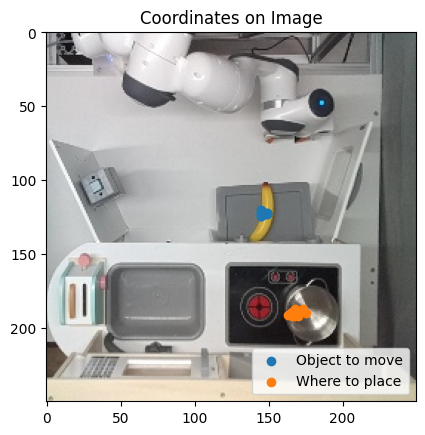

Runs with exactly two coordinates: 10


Run: 2 - Output:  (61.0, 49.0), (68.2, 72.0)
Run: 4 - Output:  (60.5, 48.7), (70.4, 73.0)
Run: 6 - Output:  (61.0, 49.0), (68.8, 74.2)
Run: 8 - Output:  (61.0, 48.1), (67.1, 76.0)
Run: 10 - Output:  (61.0, 49.0), (70.0, 75.3)


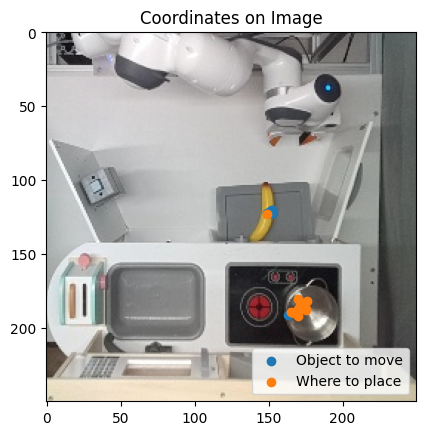

Runs with exactly two coordinates: 10


Run: 2 - Output:  (58.1, 48.8), (71.2, 75.0)
Run: 4 - Output:  (58.1, 49.5), (69.5, 74.6)
Run: 6 - Output:  (59.1, 49.4), (70.4, 73.0)
Run: 8 - Output:  (58.5, 49.7), (68.1, 75.8)
Run: 10 - Output:  (57.4, 49.0), (69.0, 74.2)


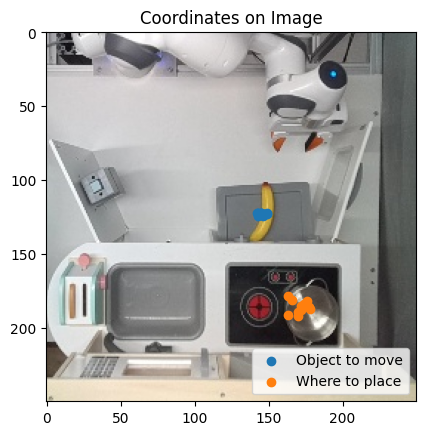

Runs with exactly two coordinates: 10


Run: 2 - Output:  (58.1, 48.7), (68.1, 75.1)
Run: 4 - Output:  (58.1, 49.4), (69.7, 78.3)
Run: 6 - Output:  (58.1, 49.2), (69.5, 74.6)
Run: 8 - Output:  (58.2, 49.7), (70.9, 76.4)
Run: 10 - Output:  (58.2, 49.0), (68.6, 76.2)


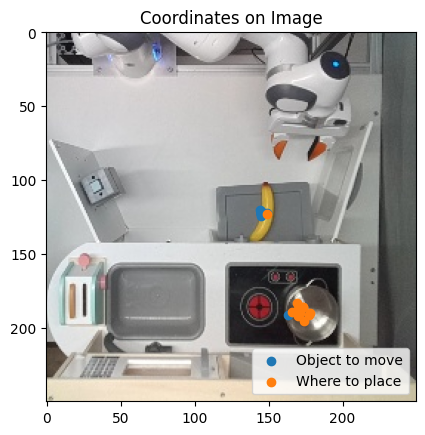

Runs with exactly two coordinates: 10


Run: 2 - Output:  (60.1, 49.0), (71.0, 75.2)
Run: 4 - Output:  (59.8, 48.7), (70.7, 74.3)
Run: 6 - Output:  (59.6, 48.7), (70.6, 77.1)
Run: 8 - Output:  (59.6, 49.8), (70.8, 76.2)
Run: 10 - Output:  (60.8, 49.7), (70.7, 77.1)


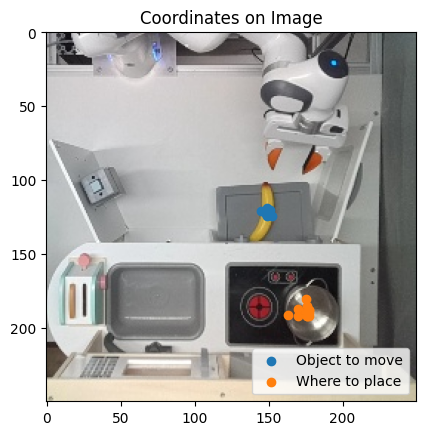

Runs with exactly two coordinates: 10


Run: 2 - Output:  (58.1, 48.8), (70.9, 74.4)
Run: 4 - Output:  (58.2, 49.7), (71.0, 76.2)
Run: 6 - Output:  (58.2, 48.2), (71.3, 76.2)
Run: 8 - Output:  (59.2, 49.0), (72.0, 76.2)
Run: 10 - Output:  (58.1, 47.9), (71.5, 75.5)


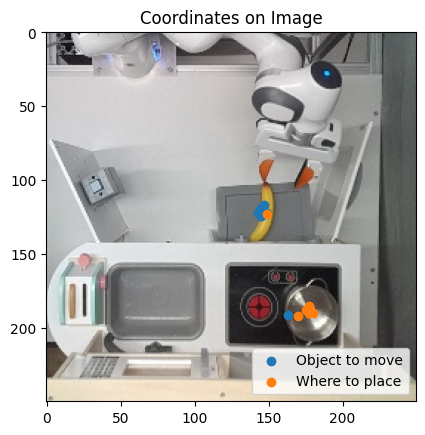

Runs with exactly two coordinates: 10


Run: 2 - Output:  (60.0, 48.2), (71.0, 76.0)
Run: 4 - Output:  (58.1, 48.7), (71.3, 74.1)
Run: 6 - Output:  (58.2, 48.7), (71.9, 77.1)
Run: 8 - Output:  (57.6, 48.0), (72.0, 75.1)
Run: 10 - Output:  (57.5, 48.1), (71.3, 75.3)


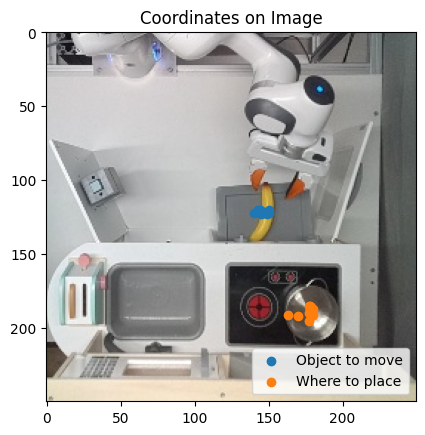

Runs with exactly two coordinates: 10


Run: 2 - Output:  (58.2, 46.9), (69.6, 73.9)
Run: 4 - Output:  (58.1, 48.7), (71.9, 75.2)
Run: 6 - Output:  (55.6, 48.5), (71.9, 76.1)
Run: 8 - Output:  (58.2, 47.8), (72.0, 76.0)
Run: 10 - Output:  (59.5, 47.0), (71.0, 76.2)


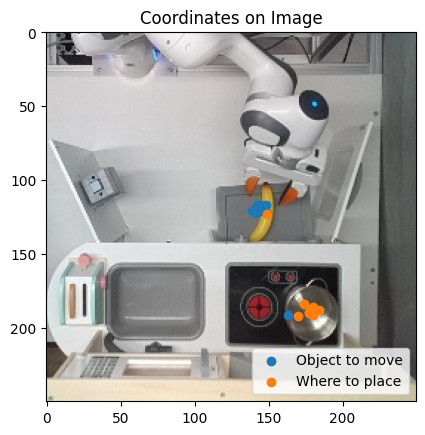

Runs with exactly two coordinates: 10


Run: 2 - Output:  (60.3, 48.2), (72.0, 74.1)
Run: 4 - Output:  (60.1, 47.7), (72.5, 75.0)
Run: 6 - Output:  (60.1, 49.7), (71.0, 74.8)
Run: 8 - Output:  (60.1, 48.0), (71.2, 77.2)
Run: 10 - Output:  (60.1, 48.4), (72.0, 75.0)


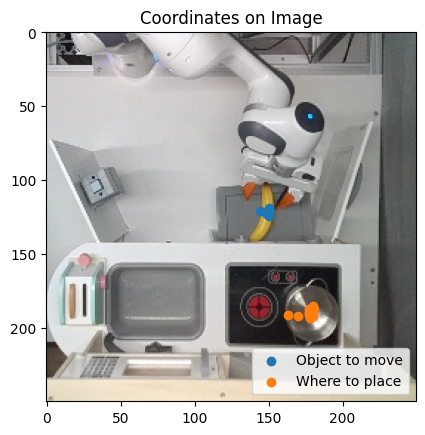

Runs with exactly two coordinates: 10


Run: 2 - Output:  (57.3, 49.0), (73.5, 76.1)
Run: 4 - Output:  (59.5, 48.7), (73.5, 74.4)
Run: 6 - Output:  (58.1, 49.5), (73.1, 74.5)
Run: 8 - Output:  (59.8, 47.1), (72.0, 75.0)
Run: 10 - Output:  (58.1, 49.7), (72.3, 76.0)


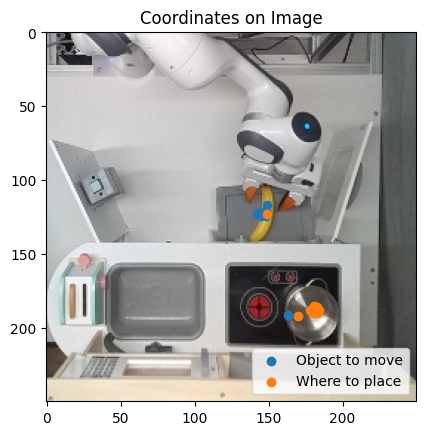

Runs with exactly two coordinates: 10


Run: 2 - Output:  (56.4, 48.9), (73.1, 77.1)
Run: 4 - Output:  (56.2, 50.0), (71.0, 76.1)
Run: 6 - Output:  (56.1, 49.0), (70.0, 73.5)
Run: 8 - Output:  (57.2, 48.8), (72.0, 75.8)
Run: 10 - Output:  (57.6, 49.2), (71.0, 76.4)


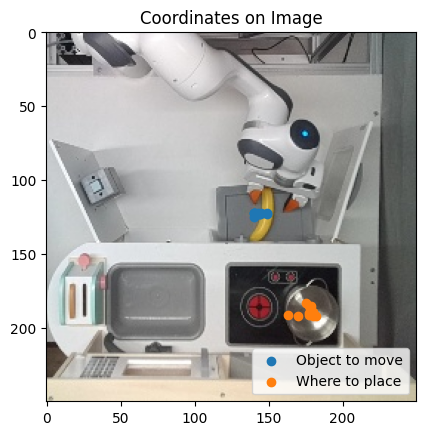

Runs with exactly two coordinates: 10


Run: 2 - Output:  (55.8, 49.9), (70.1, 76.1)
Run: 4 - Output:  (56.1, 49.0), (71.2, 75.5)
Run: 6 - Output:  (56.3, 49.5), (70.9, 73.7)
Run: 8 - Output:  (54.1, 49.0), (67.5, 73.2)
Run: 10 - Output:  (56.9, 49.2), (70.8, 76.1)


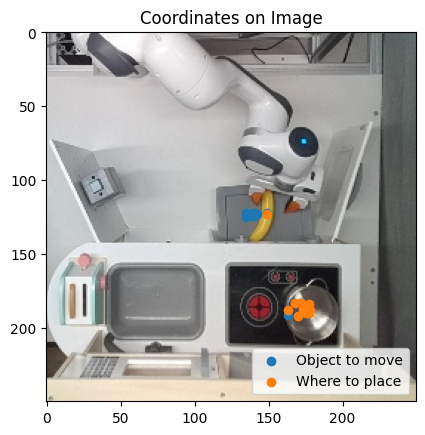

Runs with exactly two coordinates: 10


Run: 2 - Output:  (55.2, 50.0), (69.5, 76.5)
Run: 4 - Output:  (54.8, 50.2), (66.1, 77.3)
Run: 6 - Output:  (56.0, 50.5), (68.5, 76.3)
Run: 8 - Output:  (55.1, 50.0), (69.6, 78.5)
Run: 10 - Output:  (56.5, 50.8), (70.9, 75.0)


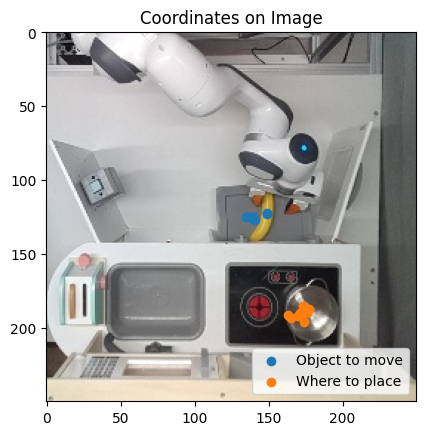

Runs with exactly two coordinates: 10


Run: 2 - Output:  (54.8, 50.0), (67.1, 75.8)
Run: 4 - Output:  (59.1, 50.0), (68.1, 76.3)
Run: 6 - Output:  (58.0, 50.0), (69.5, 74.5)
Run: 8 - Output:  (55.8, 50.0), (67.1, 75.4)
Run: 10 - Output:  (56.2, 50.7), (66.8, 74.9)


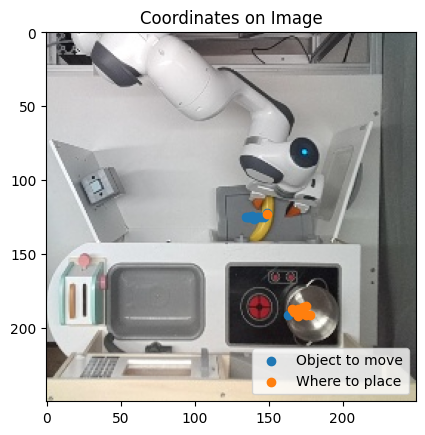

Runs with exactly two coordinates: 10


Run: 2 - Output:  (60.1, 51.0), (73.2, 74.3)
Run: 4 - Output:  (60.5, 50.2), (71.0, 74.4)
Run: 6 - Output:  (60.8, 50.0), (72.0, 75.0)
Run: 8 - Output:  (60.1, 50.0), (72.0, 75.8)
Run: 10 - Output:  (60.2, 49.7), (71.2, 75.7)


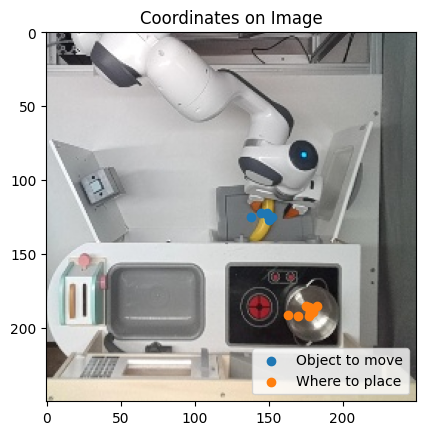

Runs with exactly two coordinates: 10


Run: 2 - Output:  (59.8, 50.0), (71.1, 76.0)
Run: 4 - Output:  (59.7, 50.5), (71.2, 76.0)
Run: 6 - Output:  (59.8, 50.1), (69.8, 75.5)
Run: 8 - Output:  (60.5, 50.5), (72.0, 75.3)
Run: 10 - Output:  (59.8, 50.0), (72.0, 75.1)


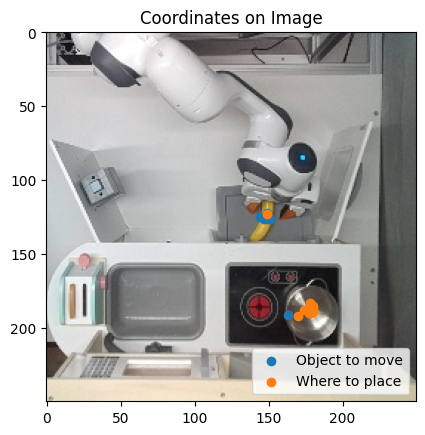

Runs with exactly two coordinates: 10


Run: 2 - Output:  (55.8, 50.0), (67.1, 76.0)
Run: 4 - Output:  (58.1, 50.0), (70.0, 75.5)
Run: 6 - Output:  (59.5, 50.0), (67.9, 76.0)
Run: 8 - Output:  (56.1, 50.1), (68.1, 74.2)
Run: 10 - Output:  (58.1, 50.0), (70.9, 76.5)


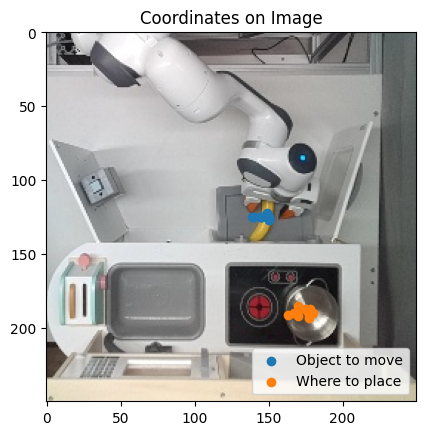

Runs with exactly two coordinates: 10


Run: 2 - Output:  (57.2, 50.2), (68.1, 76.7)
Run: 4 - Output:  (59.8, 50.0), (69.0, 74.6)
Run: 6 - Output:  (56.8, 50.0), (71.0, 74.0)
Run: 8 - Output:  (56.8, 50.0), (71.1, 75.0)
Run: 10 - Output:  (57.6, 50.0), (68.1, 75.3)


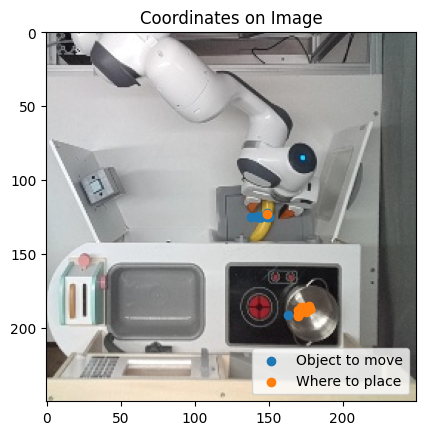

Runs with exactly two coordinates: 10


Run: 2 - Output:  (59.8, 50.0), (70.9, 75.0)
Run: 4 - Output:  (60.1, 50.2), (71.5, 75.0)
Run: 6 - Output:  (58.4, 50.0), (71.0, 75.8)
Run: 8 - Output:  (58.6, 50.0), (70.9, 75.4)
Run: 10 - Output:  (60.3, 50.0), (70.4, 75.0)


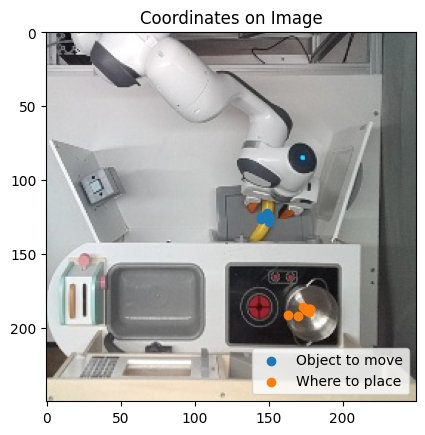

Runs with exactly two coordinates: 10


Run: 2 - Output:  (56.5, 51.1), (71.9, 78.0)
Run: 4 - Output:  (58.1, 50.7), (72.8, 75.8)
Run: 6 - Output:  (56.6, 50.7), (71.9, 75.7)
Run: 8 - Output:  (59.8, 50.0), (72.0, 75.5)
Run: 10 - Output:  (56.7, 51.4), (71.0, 75.9)


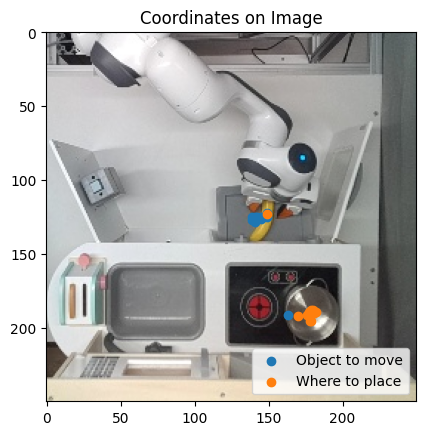

Runs with exactly two coordinates: 10


Run: 2 - Output:  (58.1, 50.1), (73.0, 74.2)
Run: 4 - Output:  (58.2, 50.0), (72.0, 75.3)
Run: 6 - Output:  (56.7, 50.2), (71.9, 76.0)
Run: 8 - Output:  (56.7, 51.0), (71.3, 73.8)
Run: 10 - Output:  (58.2, 50.2), (70.5, 77.0)


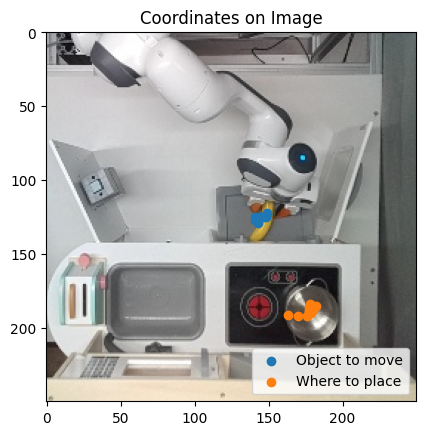

Runs with exactly two coordinates: 10


Run: 2 - Output:  (57.6, 51.0), (71.1, 73.5)
Run: 4 - Output:  (55.8, 50.1), (71.5, 77.9)
Run: 6 - Output:  (54.2, 51.0), (69.5, 73.3)
Run: 8 - Output:  (60.5, 50.0), (72.0, 75.5)
Run: 10 - Output:  (55.8, 50.4), (71.5, 78.5)


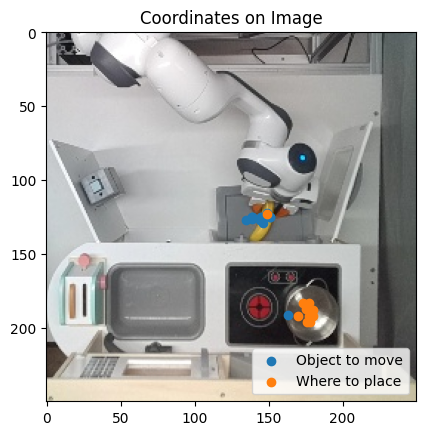

Runs with exactly two coordinates: 10


Run: 2 - Output:  (58.2, 50.0), (70.2, 75.1)
Run: 4 - Output:  (58.4, 50.0), (71.2, 75.4)
Run: 6 - Output:  (59.0, 51.4), (70.9, 76.5)
Run: 8 - Output:  (56.5, 51.4), (72.0, 77.5)
Run: 10 - Output:  (58.2, 51.0), (71.0, 76.2)


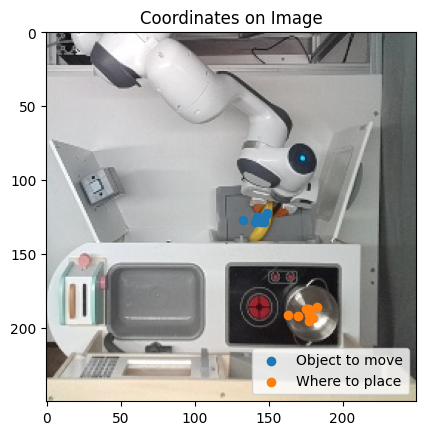

Runs with exactly two coordinates: 10


Run: 2 - Output:  (60.5, 51.5), (73.0, 74.9)
Run: 4 - Output:  (60.5, 51.6), (71.3, 75.3)
Run: 6 - Output:  (60.5, 51.2), (71.0, 75.4)
Run: 8 - Output:  (60.3, 51.7), (71.2, 76.6)
Run: 10 - Output:  (60.5, 50.0), (74.0, 77.1)


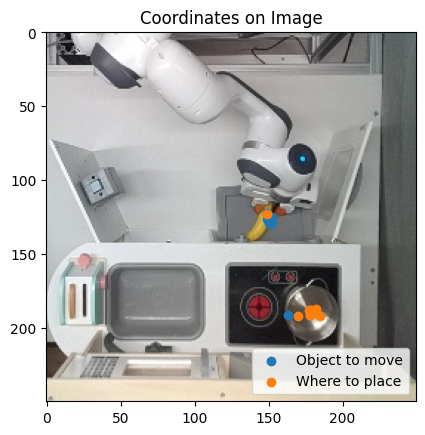

Runs with exactly two coordinates: 10


Run: 2 - Output:  (59.8, 50.8), (71.0, 75.1)
Run: 4 - Output:  (58.2, 50.7), (70.8, 74.9)
Run: 6 - Output:  (60.5, 50.0), (70.9, 75.9)
Run: 8 - Output:  (60.5, 51.0), (71.0, 76.1)
Run: 10 - Output:  (58.2, 50.0), (70.9, 76.8)


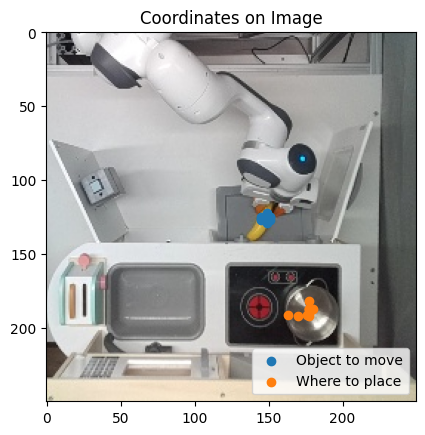

Runs with exactly two coordinates: 10


Run: 2 - Output:  (59.2, 51.8), (73.0, 74.5)
Run: 4 - Output:  (56.9, 51.2), (71.5, 76.7)
Run: 6 - Output:  (58.1, 52.0), (73.5, 75.0)
Run: 8 - Output:  (58.1, 51.7), (72.0, 75.5)
Run: 10 - Output:  (57.2, 51.0), (70.0, 73.5)


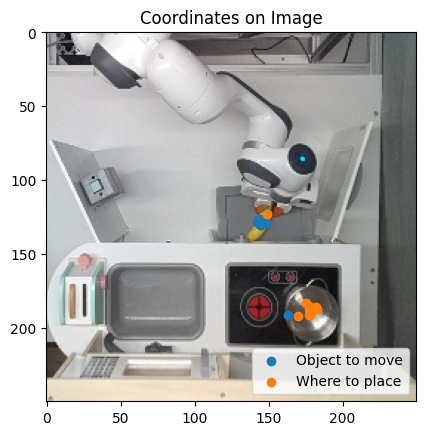

Runs with exactly two coordinates: 10


Run: 2 - Output:  (58.1, 50.8), (72.0, 75.2)
Run: 4 - Output:  (57.1, 51.7), (72.0, 76.2)
Run: 6 - Output:  (58.1, 52.0), (70.7, 73.6)
Run: 8 - Output:  (59.8, 51.1), (72.0, 76.0)
Run: 10 - Output:  (58.2, 51.1), (70.9, 75.6)


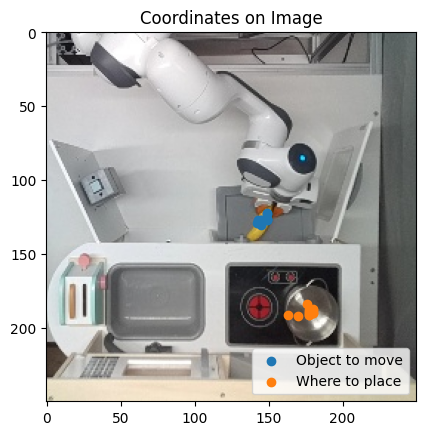

Runs with exactly two coordinates: 10


Run: 2 - Output:  (60.1, 51.7), (72.0, 75.9)
Run: 4 - Output:  (60.1, 50.0), (73.2, 76.0)
Run: 6 - Output:  (60.5, 51.4), (71.9, 74.5)
Run: 8 - Output:  (60.5, 50.7), (71.6, 75.0)
Run: 10 - Output:  (60.5, 51.1), (71.5, 75.0)


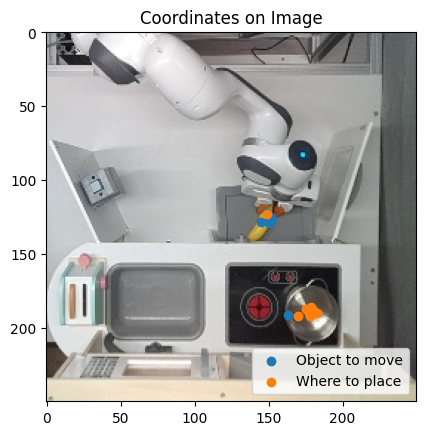

Runs with exactly two coordinates: 10


Run: 2 - Output:  (60.1, 49.2), (72.0, 75.1)
Run: 4 - Output:  (60.5, 49.8), (71.1, 75.8)
Run: 6 - Output:  (60.1, 49.6), (72.2, 76.5)
Run: 8 - Output:  (60.0, 49.5), (70.0, 76.0)
Run: 10 - Output:  (60.5, 49.8), (72.0, 75.5)


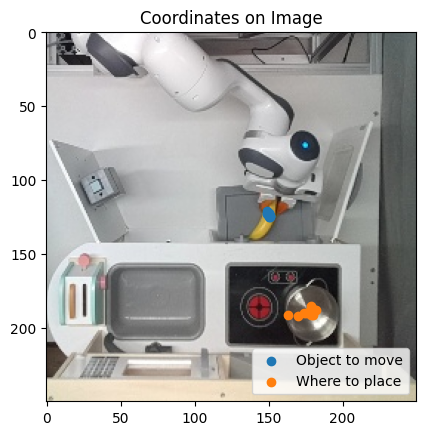

Runs with exactly two coordinates: 10


Run: 2 - Output:  (60.7, 48.5), (71.0, 75.2)
Run: 4 - Output:  (60.2, 48.0), (71.5, 75.2)
Run: 6 - Output:  (60.5, 48.5), (70.0, 75.3)
Run: 8 - Output:  (60.3, 49.2), (70.1, 74.3)
Run: 10 - Output:  (60.1, 49.0), (71.2, 74.3)


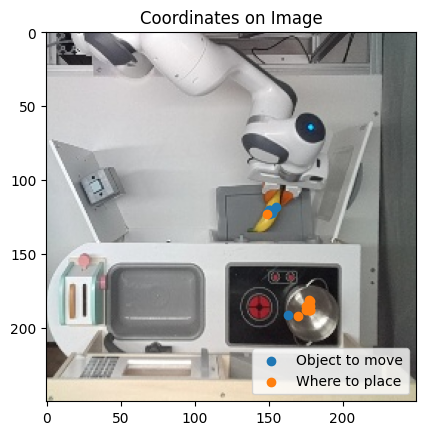

Runs with exactly two coordinates: 10


Run: 2 - Output:  (59.8, 48.7), (71.5, 74.4)
Run: 4 - Output:  (60.5, 46.4), (70.8, 76.8)
Run: 6 - Output:  (60.6, 47.2), (72.0, 74.5)
Run: 8 - Output:  (60.3, 47.2), (70.1, 75.4)
Run: 10 - Output:  (60.1, 46.9), (70.1, 75.1)


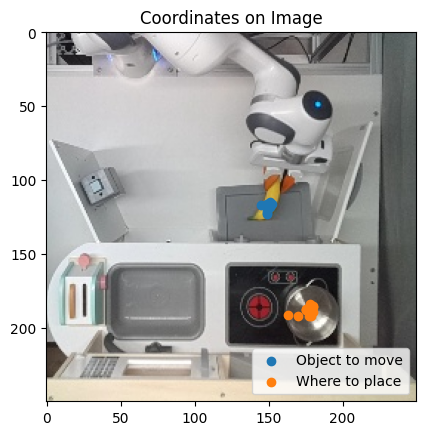

Runs with exactly two coordinates: 10


Run: 2 - Output:  (60.4, 46.0), (71.5, 76.2)
Run: 4 - Output:  (60.5, 46.2), (71.1, 74.4)
Run: 6 - Output:  (60.1, 46.4), (70.6, 74.2)
Run: 8 - Output:  (60.1, 47.4), (71.0, 76.1)
Run: 10 - Output:  (60.2, 46.9), (71.2, 75.1)


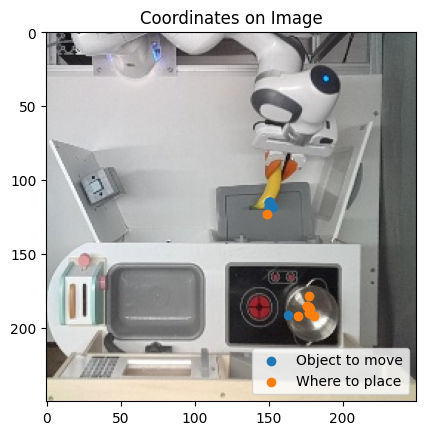

Runs with exactly two coordinates: 10


Run: 2 - Output:  (60.5, 46.2), (70.0, 76.2)
Run: 4 - Output:  (60.5, 40.2), (71.0, 76.8)
Run: 6 - Output:  (62.5, 47.4), (70.0, 75.0)
Run: 8 - Output:  (60.8, 43.2), (71.4, 75.0)
Run: 10 - Output:  (60.5, 43.9), (71.0, 75.5)


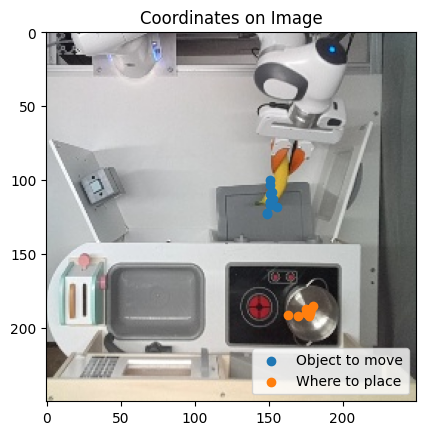

Runs with exactly two coordinates: 10


Run: 2 - Output:  (60.6, 45.8), (73.5, 73.1)
Run: 4 - Output:  (60.5, 45.6), (70.0, 75.5)
Run: 6 - Output:  (61.2, 44.5), (72.2, 74.6)
Run: 8 - Output:  (60.6, 45.5), (71.0, 75.5)
Run: 10 - Output:  (61.5, 45.6), (71.0, 75.0)


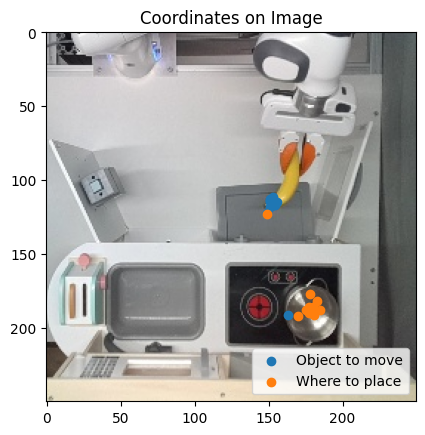

Runs with exactly two coordinates: 10


Run: 2 - Output:  (65.2, 43.6), (70.8, 75.0)
Run: 4 - Output:  (63.0, 44.6), (71.9, 76.1)
Run: 6 - Output:  (65.7, 44.5), (72.0, 76.4)
Run: 8 - Output:  (62.5, 47.1), (70.1, 77.0)
Run: 10 - Output:  (65.0, 43.3), (72.0, 72.0)


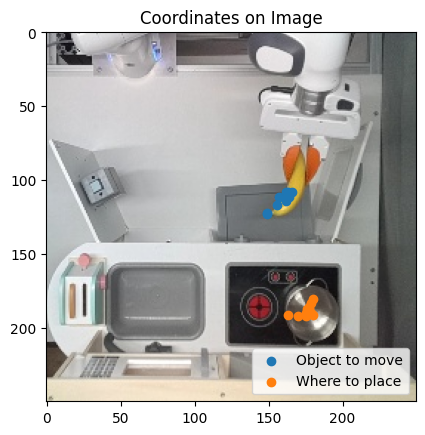

Runs with exactly two coordinates: 10


Run: 2 - Output:  (62.6, 48.5), (72.0, 75.0)
Run: 4 - Output:  (62.5, 49.1), (70.6, 74.6)
Run: 6 - Output:  (60.8, 47.5), (71.9, 71.6)
Run: 8 - Output:  (62.5, 47.3), (72.1, 75.0)
Run: 10 - Output:  (62.5, 48.5), (70.1, 75.1)


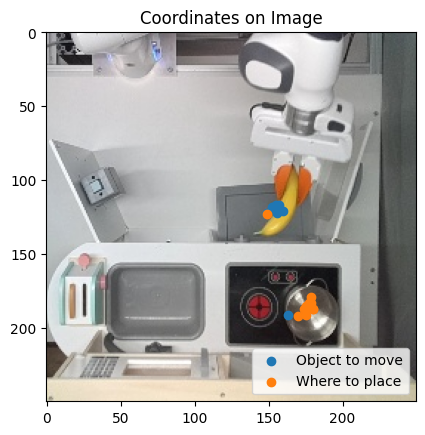

Runs with exactly two coordinates: 10


Run: 2 - Output:  (61.0, 54.7), (71.0, 76.2)
Run: 4 - Output:  (61.1, 53.5), (72.0, 76.3)
Run: 6 - Output:  (62.6, 52.6), (71.0, 75.0)
Run: 8 - Output:  (62.5, 55.8), (69.7, 74.2)
Run: 10 - Output:  (61.6, 55.0), (72.0, 75.7)


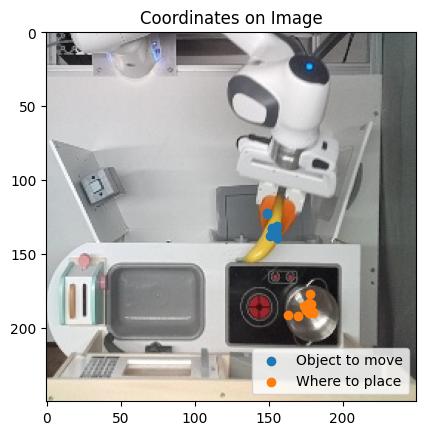

Runs with exactly two coordinates: 10


Run: 2 - Output:  (59.7, 58.3), (72.0, 74.9)
Run: 4 - Output:  (59.0, 62.9), (71.5, 76.2)
Run: 6 - Output:  (58.1, 63.5), (71.9, 73.6)
Run: 8 - Output:  (58.6, 63.4), (71.0, 76.7)
Run: 10 - Output:  (58.1, 63.5), (72.0, 75.6)


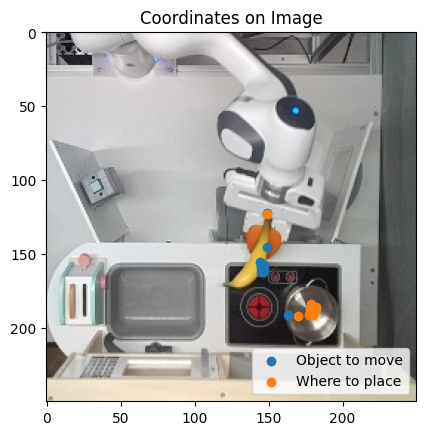

Runs with exactly two coordinates: 10


Run: 2 - Output:  (54.1, 67.1), (73.5, 75.5)
Run: 4 - Output:  (54.8, 66.4), (70.9, 76.5)
Run: 6 - Output:  (54.2, 66.2), (72.2, 75.5)
Run: 8 - Output:  (53.5, 66.1), (70.9, 76.1)
Run: 10 - Output:  (54.8, 67.0), (73.5, 74.6)


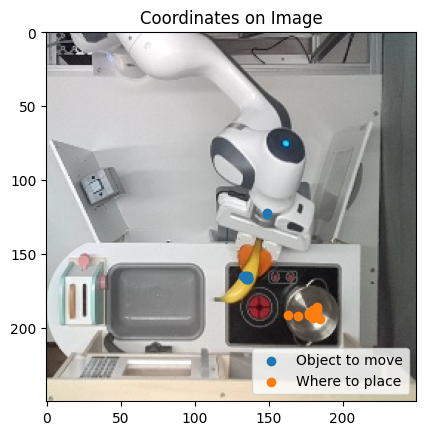

Runs with exactly two coordinates: 10


Run: 2 - Output:  (53.5, 69.2), (70.9, 75.2)
Run: 4 - Output:  (53.1, 68.7), (69.7, 77.6)
Run: 6 - Output:  (53.1, 70.0), (69.7, 77.1)
Run: 8 - Output:  (53.2, 69.0), (71.9, 77.1)
Run: 10 - Output:  (52.5, 70.2), (64.5, 73.2)


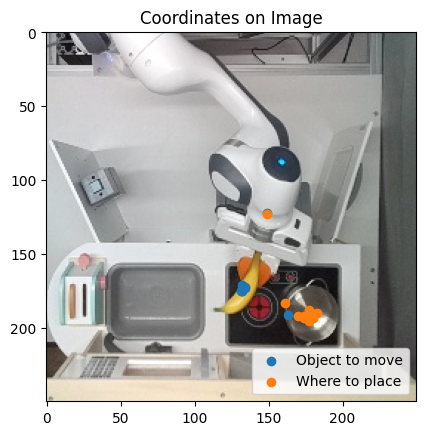

Runs with exactly two coordinates: 10


Run: 2 - Output:  (55.6, 71.8), (73.5, 79.5)
Run: 4 - Output:  (55.6, 72.7), (72.7, 75.1)
Run: 6 - Output:  (55.0, 71.5), (74.7, 74.5)
Run: 8 - Output:  (55.6, 73.1), (73.5, 76.4)
Run: 10 - Output:  (55.6, 73.2), (74.4, 75.9)


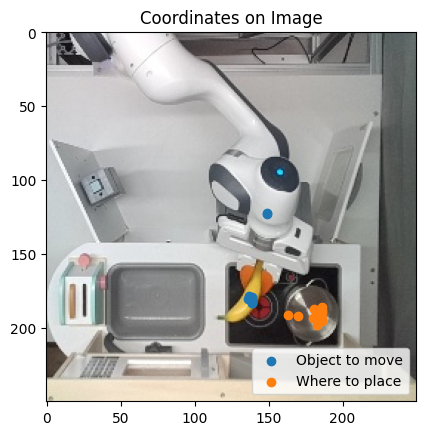

Runs with exactly two coordinates: 10


Run: 2 - Output:  (56.0, 74.5), (73.5, 79.6)
Run: 4 - Output:  (56.7, 74.2), (74.0, 74.2)
Run: 6 - Output:  (56.8, 74.2), (73.6, 76.0)
Run: 8 - Output:  (55.8, 74.2), (73.1, 77.5)
Run: 10 - Output:  (55.8, 74.1), (74.1, 74.1)


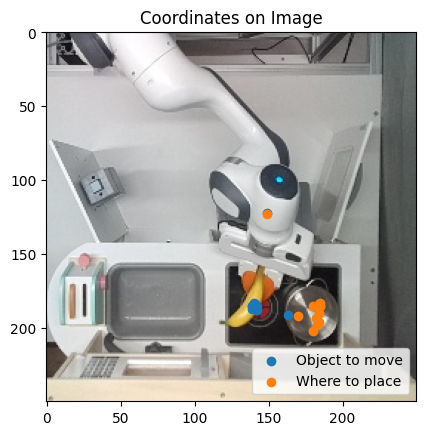

Runs with exactly two coordinates: 10


Run: 2 - Output:  (57.1, 75.7), (72.0, 75.7)
Run: 4 - Output:  (58.2, 75.4), (74.2, 75.4)
Run: 6 - Output:  (58.7, 75.1), (72.0, 75.1)
Run: 8 - Output:  (58.1, 73.5), (74.3, 73.5)
Run: 10 - Output:  (58.1, 75.0), (72.7, 73.7)


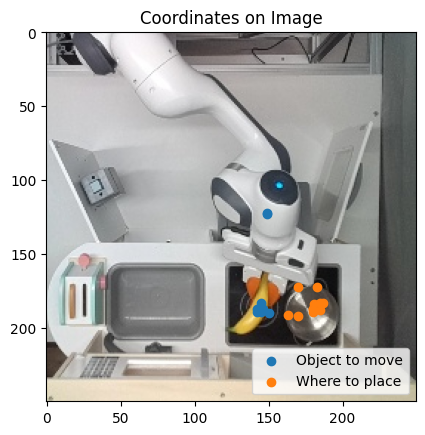

Runs with exactly two coordinates: 10


Run: 2 - Output:  (58.1, 76.5), (76.5, 68.0)
Run: 4 - Output:  (57.3, 75.3), (75.0, 69.0)
Run: 6 - Output:  (58.2, 75.1), (74.7, 69.0)
Run: 8 - Output:  (57.1, 77.1), (77.1, 69.8)
Run: 10 - Output:  (59.8, 76.3), (76.9, 65.9)


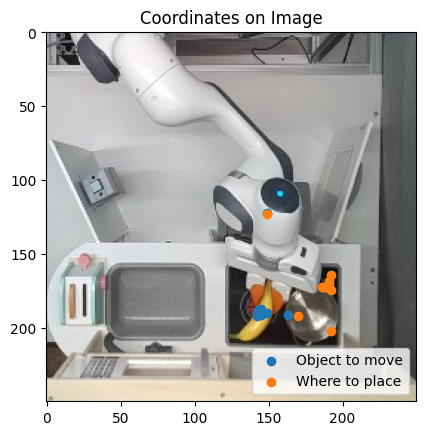

Runs with exactly two coordinates: 10


Run: 2 - Output:  (60.1, 77.1), (76.3, 69.0)
Run: 4 - Output:  (61.5, 77.7), (75.8, 75.8)
Run: 6 - Output:  (60.5, 76.5), (77.8, 69.9)
Run: 8 - Output:  (60.5, 77.2), (75.2, 81.5)
Run: 10 - Output:  (59.6, 77.2), (77.6, 68.3)


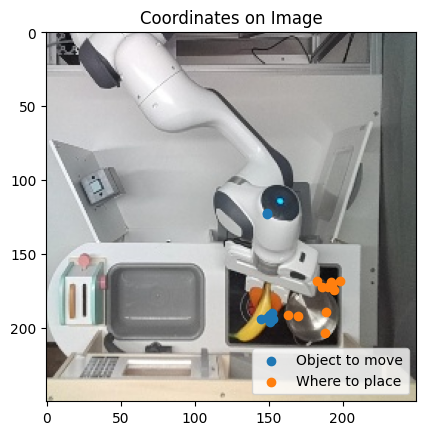

Runs with exactly two coordinates: 10


Run: 2 - Output:  (58.1, 76.0), (73.3, 68.0)
Run: 4 - Output:  (57.7, 76.8), (73.5, 68.6)
Run: 6 - Output:  (57.9, 78.0), (75.0, 75.0)
Run: 8 - Output:  (57.6, 76.1), (73.7, 67.6)
Run: 10 - Output:  (57.6, 76.5), (74.3, 69.0)


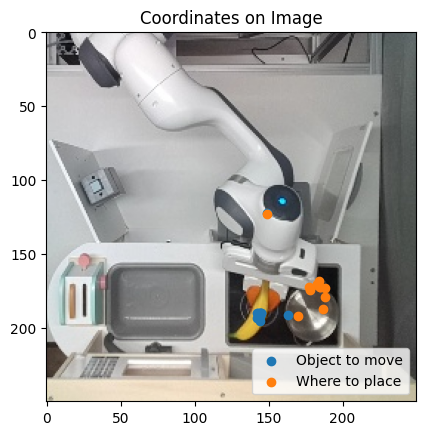

Runs with exactly two coordinates: 10


Run: 2 - Output:  (57.1, 78.0), (75.1, 74.9)
Run: 4 - Output:  (58.6, 76.0), (73.0, 69.8)
Run: 6 - Output:  (56.9, 76.2), (75.0, 73.4)
Run: 8 - Output:  (57.0, 76.5), (75.0, 75.0)
Run: 10 - Output:  (57.6, 76.5), (76.5, 76.5)


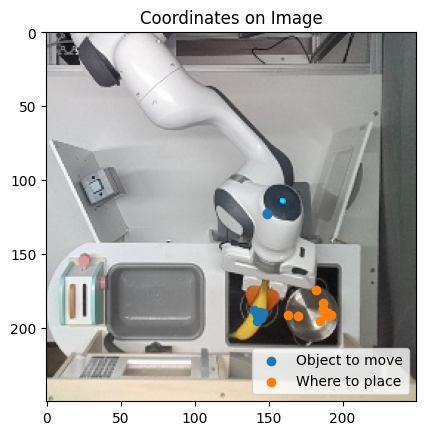

Runs with exactly two coordinates: 10


Run: 2 - Output:  (56.2, 75.5), (75.2, 75.5)
Run: 4 - Output:  (56.1, 75.4), (73.5, 78.5)
Run: 6 - Output:  (56.0, 75.8), (72.5, 78.5)
Run: 8 - Output:  (55.2, 75.4), (73.0, 76.7)
Run: 10 - Output:  (56.9, 76.4), (75.2, 77.0)


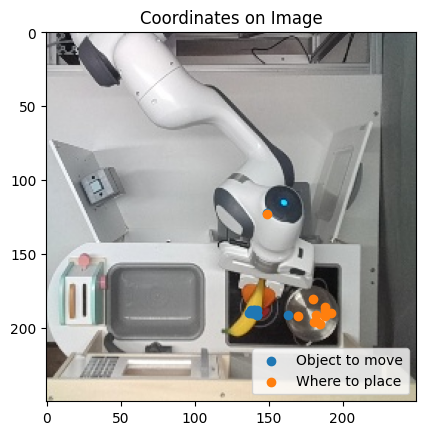

Runs with exactly two coordinates: 10


Run: 2 - Output:  (55.6, 75.6), (77.0, 75.6)
Run: 4 - Output:  (55.9, 75.8), (74.1, 74.2)
Run: 6 - Output:  (54.8, 74.8), (77.5, 77.5)
Run: 8 - Output:  (56.0, 75.2), (73.5, 77.8)
Run: 10 - Output:  (56.5, 74.9), (75.0, 76.0)


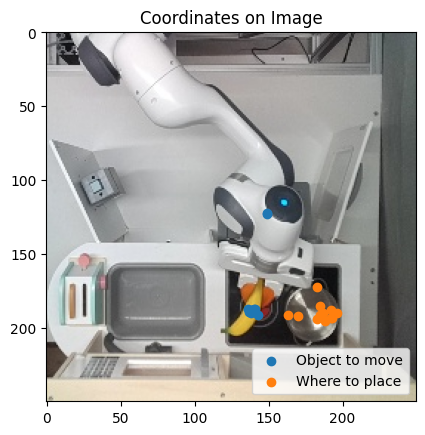

Runs with exactly two coordinates: 10


Run: 2 - Output:  (55.6, 75.4), (76.1, 79.9)
Run: 4 - Output:  (55.8, 74.8), (74.2, 74.8)
Run: 6 - Output:  (54.8, 75.2), (77.0, 78.0)
Run: 8 - Output:  (54.8, 75.2), (76.0, 76.0)
Run: 10 - Output:  (55.6, 75.0), (74.3, 75.0)


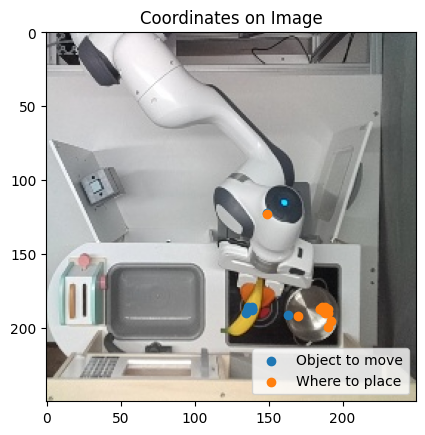

Runs with exactly two coordinates: 10


Run: 2 - Output:  (56.0, 75.3), (75.0, 75.0)
Run: 4 - Output:  (55.6, 75.4), (74.7, 75.0)
Run: 6 - Output:  (55.6, 75.6), (75.6, 68.8)
Run: 8 - Output:  (56.0, 75.4), (75.2, 75.4)
Run: 10 - Output:  (54.8, 75.0), (77.3, 76.1)


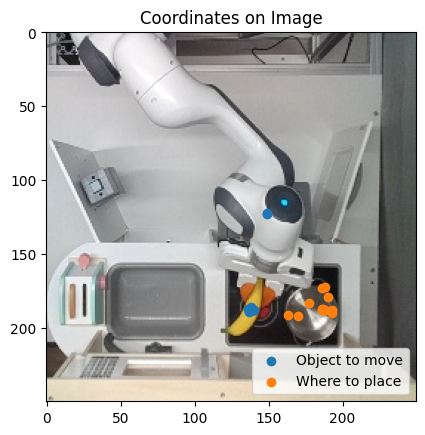

Runs with exactly two coordinates: 10


Run: 2 - Output:  (57.0, 75.9), (76.1, 75.9)
Run: 4 - Output:  (56.0, 74.5), (72.6, 68.0)
Run: 6 - Output:  (57.0, 75.0), (75.0, 75.0)
Run: 8 - Output:  (55.6, 75.7), (74.4, 80.9)
Run: 10 - Output:  (58.0, 75.4), (74.6, 69.0)


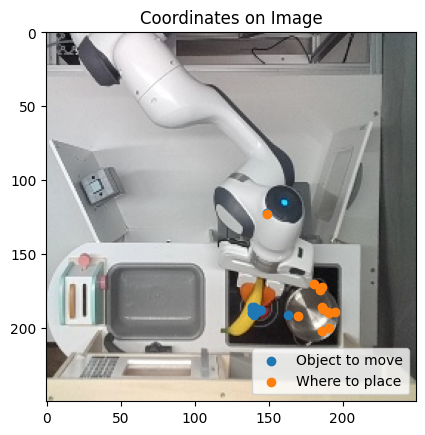

Runs with exactly two coordinates: 10


Run: 2 - Output:  (55.6, 75.5), (76.1, 76.8)
Run: 4 - Output:  (54.8, 76.1), (76.1, 77.0)
Run: 6 - Output:  (54.8, 75.2), (77.5, 75.2)
Run: 8 - Output:  (55.6, 75.7), (76.3, 77.0)
Run: 10 - Output:  (55.4, 75.1), (75.3, 75.1)


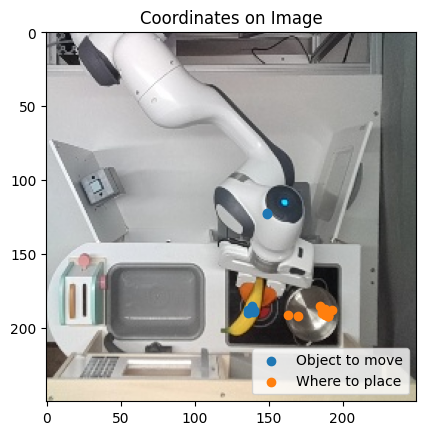

Runs with exactly two coordinates: 10


Run: 2 - Output:  (56.0, 75.5), (74.5, 78.2)
Run: 4 - Output:  (56.0, 75.9), (74.7, 75.9)
Run: 6 - Output:  (56.0, 75.5), (75.2, 80.0)
Run: 8 - Output:  (56.0, 74.7), (76.5, 76.5)
Run: 10 - Output:  (57.0, 74.3), (74.5, 79.2)


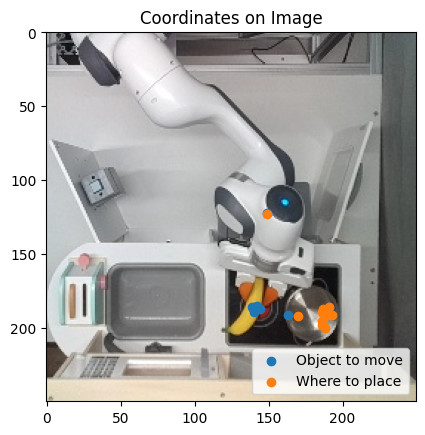

Runs with exactly two coordinates: 10


Run: 2 - Output:  (56.6, 74.5), (74.2, 74.5)
Run: 4 - Output:  (56.0, 75.0), (77.5, 77.5)
Run: 6 - Output:  (55.2, 75.4), (73.2, 80.0)
Run: 8 - Output:  (56.0, 76.1), (72.0, 80.0)
Run: 10 - Output:  (56.7, 75.7), (76.1, 75.7)


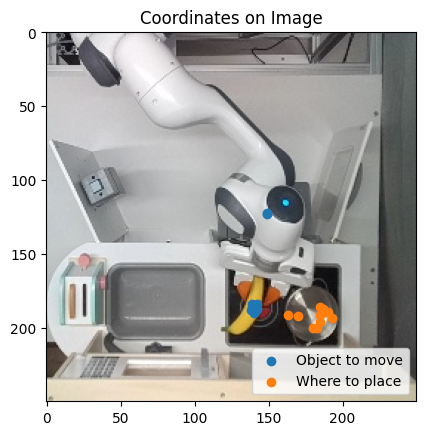

Runs with exactly two coordinates: 10


Run: 2 - Output:  (56.1, 75.2), (78.0, 75.0)
Run: 4 - Output:  (55.6, 74.2), (77.6, 76.0)
Run: 6 - Output:  (56.0, 75.2), (73.5, 69.3)
Run: 8 - Output:  (55.9, 73.7), (73.5, 72.7)
Run: 10 - Output:  (56.0, 75.9), (77.5, 75.9)


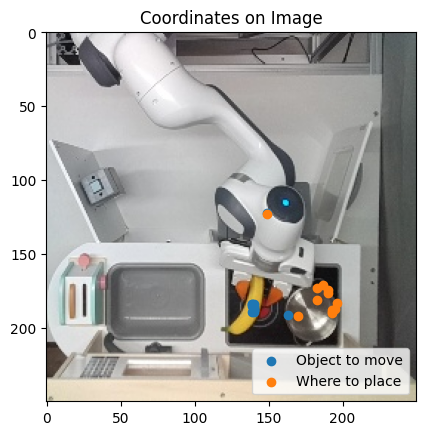

Runs with exactly two coordinates: 10


Run: 2 - Output:  (54.1, 74.6), (76.1, 68.8)
Run: 4 - Output:  (56.0, 74.6), (77.5, 67.1)
Run: 6 - Output:  (56.0, 74.5), (75.2, 75.1)
Run: 8 - Output:  (56.7, 73.3), (76.5, 62.2)
Run: 10 - Output:  (55.6, 75.8), (79.5, 68.0)


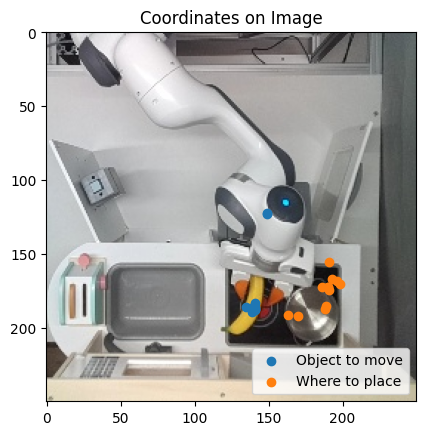

Runs with exactly two coordinates: 10


Run: 2 - Output:  (56.0, 74.7), (76.8, 74.7)
Run: 4 - Output:  (56.7, 76.5), (74.2, 81.0)
Run: 6 - Output:  (56.9, 74.0), (75.0, 80.0)
Run: 8 - Output:  (57.3, 74.1), (75.0, 74.1)
Run: 10 - Output:  (57.0, 75.9), (78.7, 75.5)


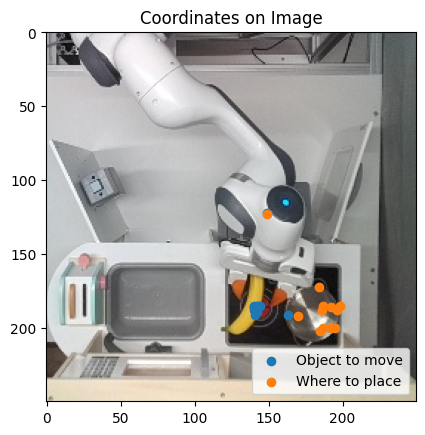

Runs with exactly two coordinates: 10


Run: 2 - Output:  (57.4, 75.4), (75.0, 69.4)
Run: 4 - Output:  (56.5, 75.3), (75.0, 81.0)
Run: 6 - Output:  (55.8, 74.5), (74.5, 80.7)
Run: 8 - Output:  (56.7, 75.7), (75.6, 80.1)
Run: 10 - Output:  (57.0, 75.1), (72.5, 75.1)


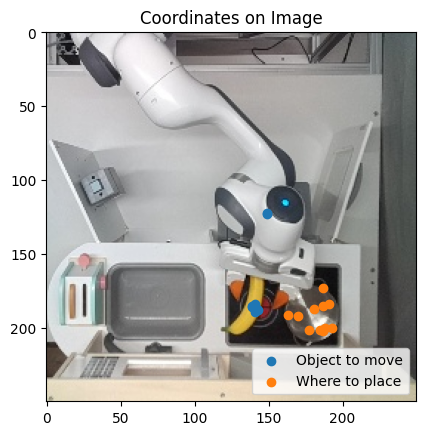

Runs with exactly two coordinates: 10


Run: 2 - Output:  (55.6, 75.2), (76.1, 80.0)
Run: 4 - Output:  (56.9, 75.0), (76.6, 74.1)
Run: 6 - Output:  (56.9, 74.5), (76.3, 75.7)
Run: 8 - Output:  (56.0, 75.2), (76.1, 79.6)
Run: 10 - Output:  (56.4, 75.5), (76.4, 80.4)


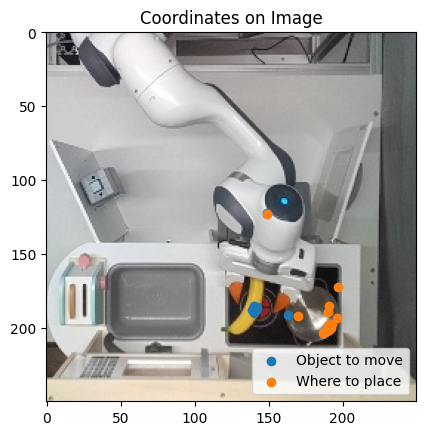

Runs with exactly two coordinates: 10


Run: 2 - Output:  (55.9, 75.7), (76.1, 65.2)
Run: 4 - Output:  (57.1, 75.9), (77.3, 69.8)
Run: 6 - Output:  (57.3, 74.5), (79.5, 71.9)
Run: 8 - Output:  (57.1, 75.0), (76.5, 80.1)
Run: 10 - Output:  (56.0, 75.9), (77.9, 69.2)


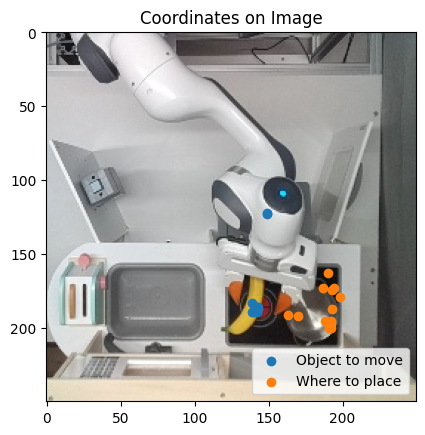

Runs with exactly two coordinates: 10


Run: 2 - Output:  (56.9, 75.0), (77.5, 75.0)
Run: 4 - Output:  (55.6, 74.5), (78.7, 77.4)
Run: 6 - Output:  (54.2, 74.4), (77.0, 69.4)
Run: 8 - Output:  (55.6, 75.7), (76.6, 69.2)
Run: 10 - Output:  (55.8, 75.0), (75.0, 75.0)


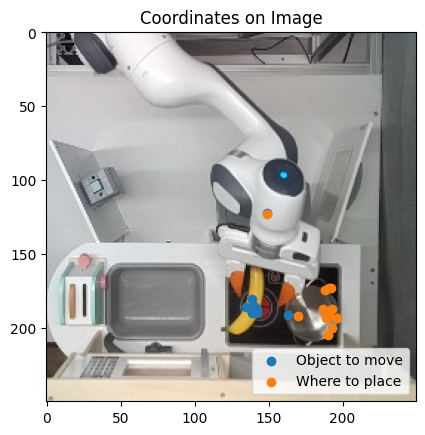

Runs with exactly two coordinates: 10




In [5]:
tasks, trajectories, ground_truths, _ = extract_all_trajectories("../data/trajectory_kit")

for i in range(len(tasks)):
    outputs = []
    trajectory = trajectories[i]
    task = tasks[i]
    prompt = prompt_start + task + prompt_1 + prompt_end

    print(f"Task: {task}")
    for image in trajectory:
        runs_with_two_coords = 0
        image_width = image.width
        image_height = image.height
        for j in range(10):
            output = do_inference(image, prompt, model, processor)
            coordinates = get_coordinates(output, image_width, image_height)
            if len(coordinates) == 2:
                runs_with_two_coords += 1
                outputs.append(coordinates)
    
            if ((j+1) % 2) == 0: 
                print(f"Run: {j + 1} - Output: {output}")
    
        labels = ["Object to move", "Where to place"]
    
        outputs = refactor_coordinates_to_where_to_place(outputs)
        visualize_points_on_image(image, labels, outputs)
        #plot_euclidean_bplot(labels, outputs, ground_truths, title)
        print(f"Runs with exactly two coordinates: {runs_with_two_coords}")
        print("")
        print("")

Task: close the microwave.
Run: 2 - Output:  (84.2, 18.0), (84.2, 26.8)
Run: 4 - Output:  (86.9, 19.8), (87.0, 15.9)
Run: 6 - Output:  (85.1, 22.7), (85.1, 12.0)
Run: 8 - Output:  (83.5, 20.8), (84.2, 11.1)
Run: 10 - Output:  (85.4, 20.2), (85.4, 13.5)


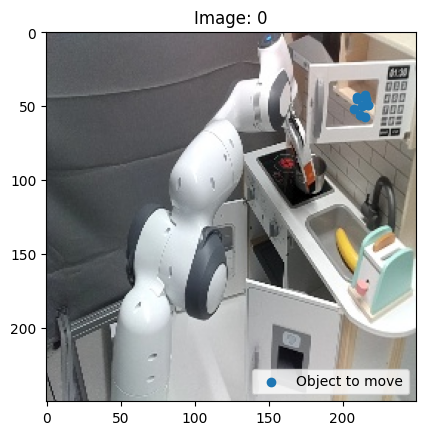

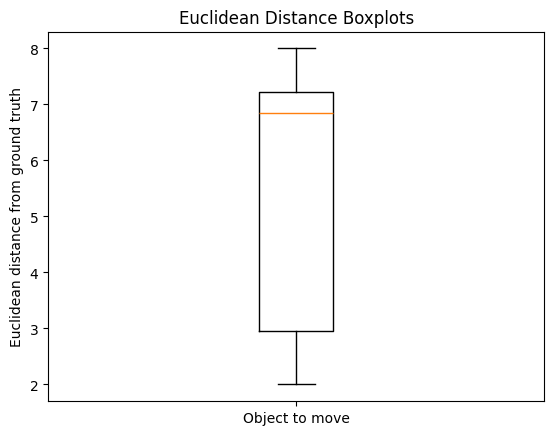

Runs with exactly two coordinates: 10


Run: 2 - Output:  (84.7, 20.0), (85.0, 12.0)
Run: 4 - Output:  (85.3, 24.0), (85.3, 14.2)
Run: 6 - Output:  (82.6, 18.5), (82.6, 25.8)
Run: 8 - Output:  (85.3, 19.2), (85.3, 25.9)
Run: 10 - Output:  (83.2, 22.0), (83.2, 12.9)


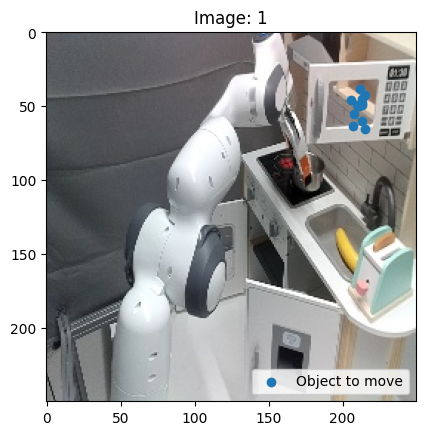

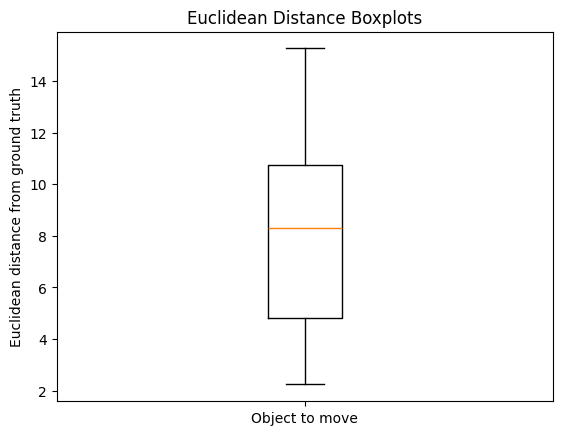

Runs with exactly two coordinates: 10


Run: 2 - Output:  (85.5, 25.2), (85.5, 15.2)
Run: 4 - Output:  (85.6, 20.5), (85.6, 12.9)
Run: 6 - Output:  (84.0, 23.0), (84.0, 13.0)
Run: 8 - Output:  (83.3, 19.5), (83.3, 25.6)
Run: 10 - Output:  (84.3, 20.5), (84.3, 12.6)


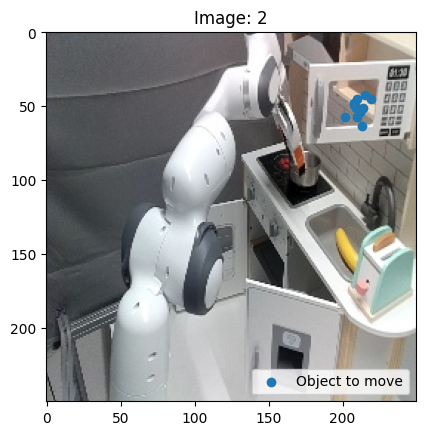

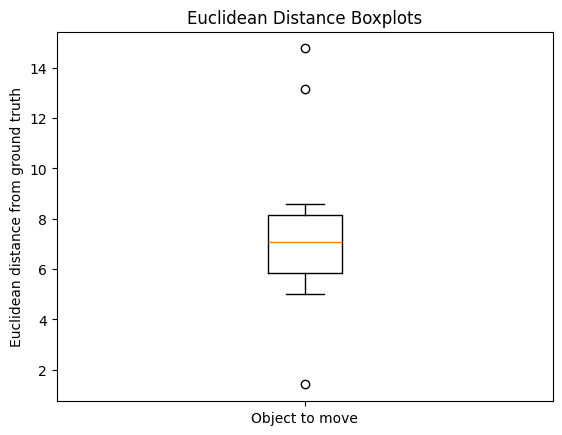

Runs with exactly two coordinates: 10


Run: 2 - Output:  (80.6, 20.5), (81.0, 10.3)
Run: 4 - Output:  (83.1, 20.2), (83.1, 10.6)
Run: 6 - Output:  (83.0, 23.0), (83.0, 15.0)
Run: 8 - Output:  (82.6, 19.6), (83.1, 13.3)
Run: 10 - Output:  (85.3, 19.0), (85.3, 27.0)


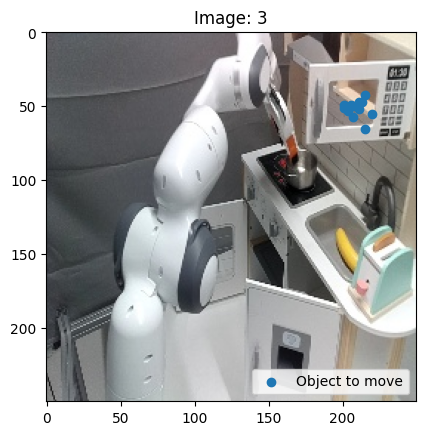

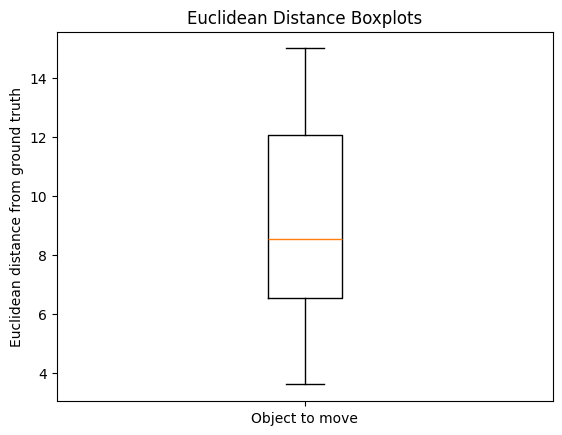

Runs with exactly two coordinates: 10


Run: 2 - Output:  (86.0, 19.5), (86.0, 10.4)
Run: 4 - Output:  (86.5, 18.5), (86.5, 24.5)
Run: 6 - Output:  (85.4, 13.5), (85.4, 24.3)
Run: 8 - Output:  (86.5, 18.1), (86.5, 26.2)
Run: 10 - Output:  (87.9, 17.9), (88.3, 10.9)


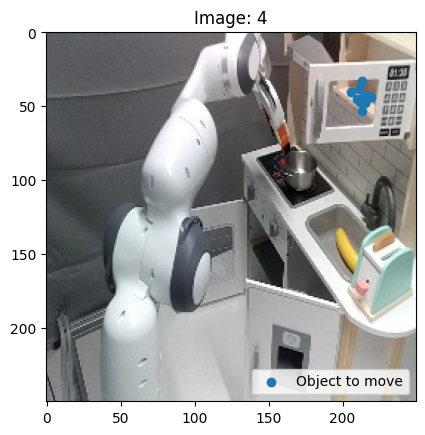

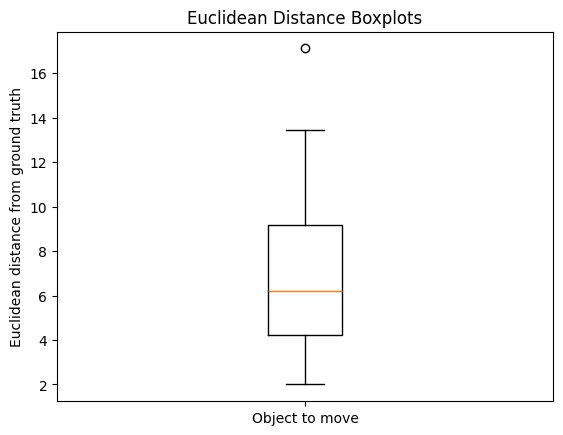

Runs with exactly two coordinates: 10


Run: 2 - Output:  (85.8, 13.5), (86.0, 24.0)
Run: 4 - Output:  (87.9, 18.0), (88.0, 25.1)
Run: 6 - Output:  (86.5, 19.5), (86.5, 14.8)
Run: 8 - Output:  (85.3, 18.5), (85.3, 26.4)
Run: 10 - Output:  (85.5, 19.8), (85.5, 13.1)


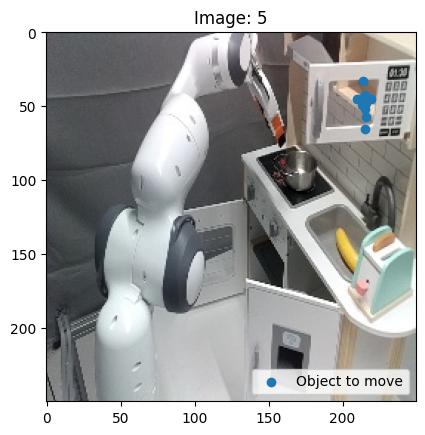

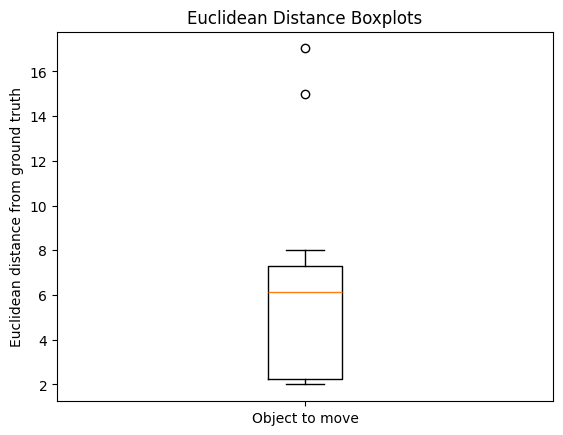

Runs with exactly two coordinates: 10


Run: 2 - Output:  (88.2, 17.7), (88.2, 24.3)
Run: 4 - Output:  (87.9, 18.5), (88.2, 24.0)
Run: 6 - Output:  (84.3, 17.5), (84.3, 27.0)
Run: 8 - Output:  (86.7, 18.0), (86.7, 24.3)
Run: 10 - Output:  (86.3, 19.8), (86.3, 25.5)


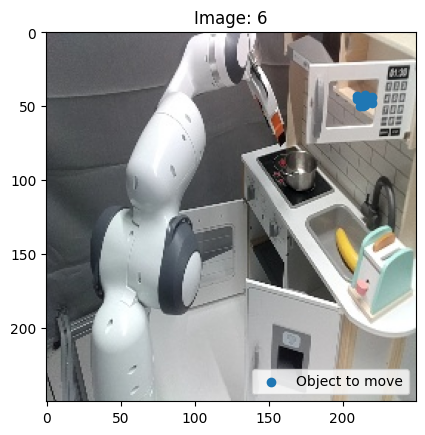

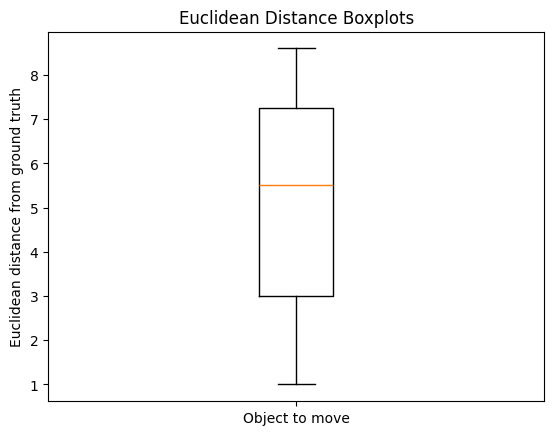

Runs with exactly two coordinates: 10


Run: 2 - Output:  (85.5, 18.5), (86.3, 10.6)
Run: 4 - Output:  (85.4, 20.0), (86.1, 11.9)
Run: 6 - Output:  (86.5, 16.5), (87.9, 15.3)
Run: 8 - Output:  (85.5, 20.5), (86.1, 14.3)
Run: 10 - Output:  (86.7, 18.0), (86.7, 25.0)


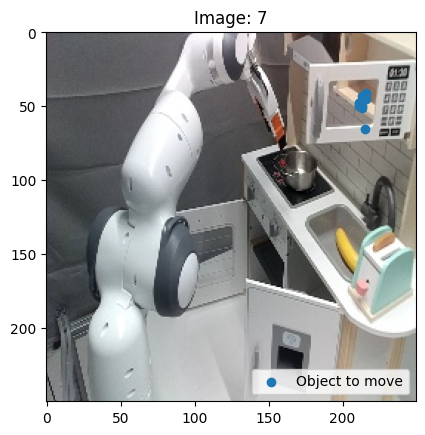

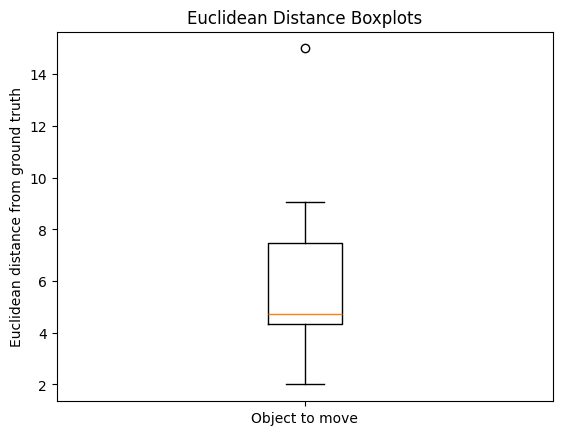

Runs with exactly two coordinates: 10


Run: 2 - Output:  (87.6, 19.6), (87.6, 11.8)
Run: 4 - Output:  (88.2, 16.5), (88.2, 19.8)
Run: 6 - Output:  (86.0, 18.9), (86.0, 25.1)
Run: 8 - Output:  (86.9, 18.1), (87.0, 12.7)
Run: 10 - Output:  (85.8, 19.8), (86.0, 12.3)


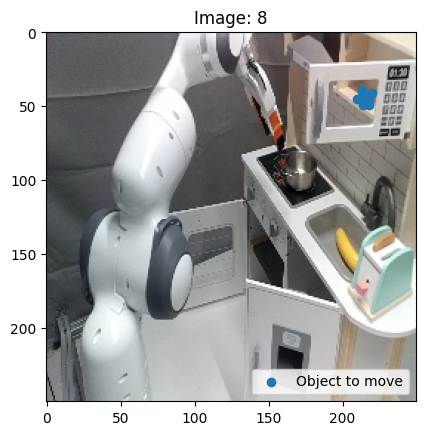

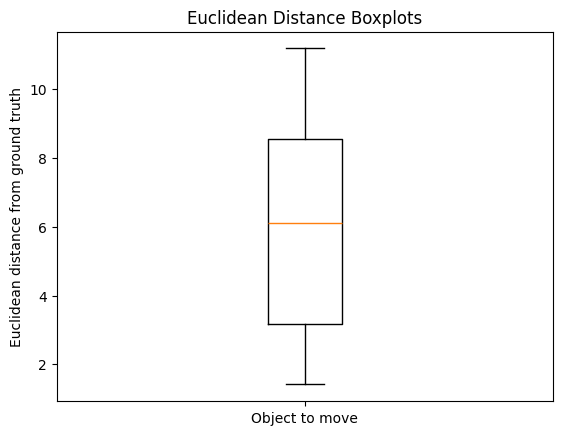

Runs with exactly two coordinates: 10


Run: 2 - Output:  (86.5, 19.6), (86.5, 24.8)
Run: 4 - Output:  (86.0, 22.8), (86.0, 13.1)
Run: 6 - Output:  (88.2, 20.0), (88.2, 10.0)
Run: 8 - Output:  (86.8, 19.0), (87.4, 12.2)
Run: 10 - Output:  (85.3, 19.2), (85.3, 13.2)


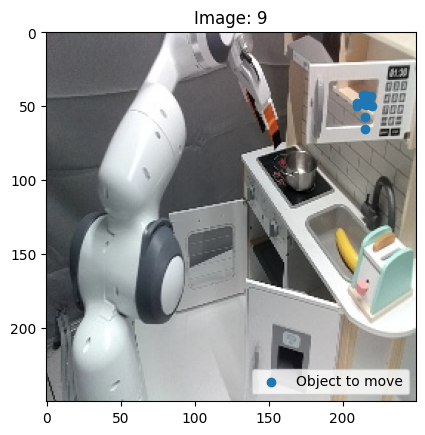

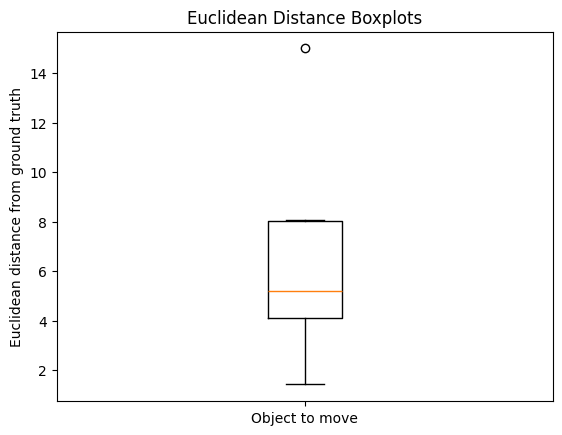

Runs with exactly two coordinates: 10


Run: 2 - Output:  (83.3, 18.8), (83.3, 27.0)
Run: 4 - Output:  (81.5, 19.9), (81.5, 11.9)
Run: 6 - Output:  (83.9, 18.0), (84.0, 26.3)
Run: 8 - Output:  (83.4, 12.0), (83.4, 21.8)
Run: 10 - Output:  (83.0, 18.9), (83.0, 19.5), (83.0, 20.4), (83.0, 21.2), (83.0, 22.0), (83.0, 22.8), (83.0, 23.5), (83.0, 24.2), (83.0, 25.0), (83.0, 25.7), (83.0, 26.5), (83.0, 27.2), (83.0, 28.0), (83.0, 28.6), (83.0, 29.3), (83.0, 30.0), (83.0, 3


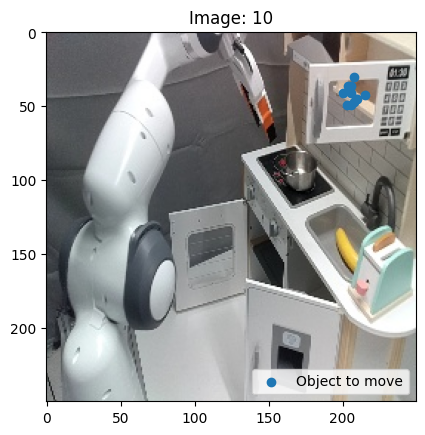

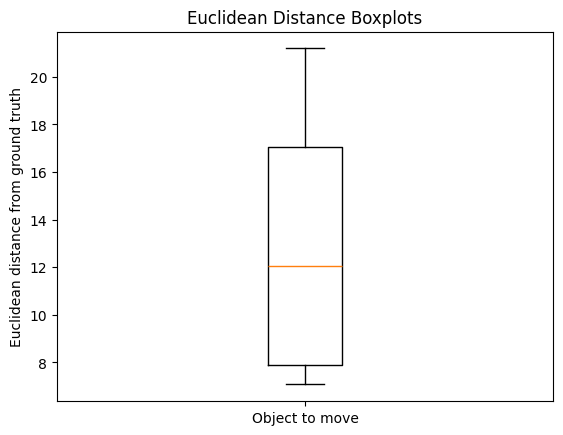

Runs with exactly two coordinates: 9


Run: 2 - Output:  (83.5, 19.9), (83.5, 11.1)
Run: 4 - Output:  (83.7, 16.3), (83.7, 19.8)
Run: 6 - Output:  (86.9, 15.1), (87.9, 14.3)
Run: 8 - Output:  (85.2, 16.1), (85.2, 24.3)
Run: 10 - Output:  (81.5, 19.8), (81.5, 12.2)


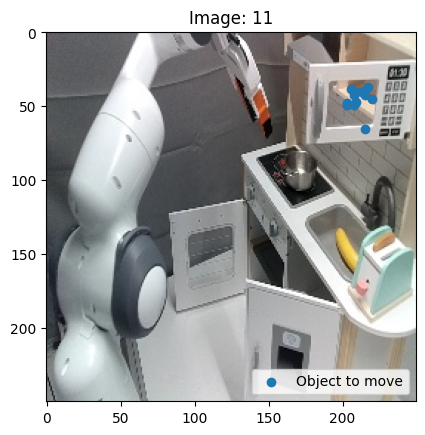

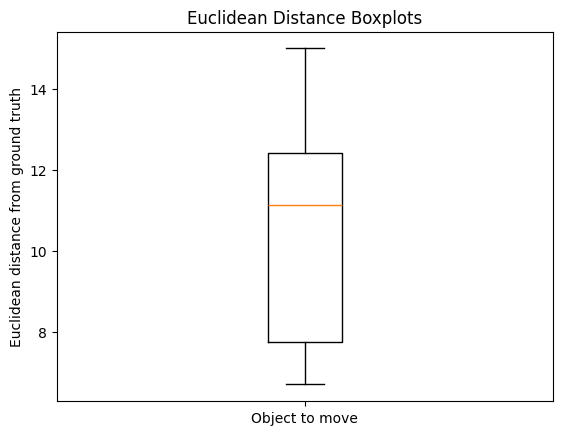

Runs with exactly two coordinates: 10


Run: 2 - Output:  (84.5, 19.8), (84.5, 13.3)
Run: 4 - Output:  (80.5, 19.2), (80.5, 10.8)
Run: 6 - Output:  (85.8, 18.0), (86.5, 11.7)
Run: 8 - Output:  (83.7, 19.1), (84.0, 10.2)
Run: 10 - Output:  (82.6, 16.0), (82.6, 27.0)


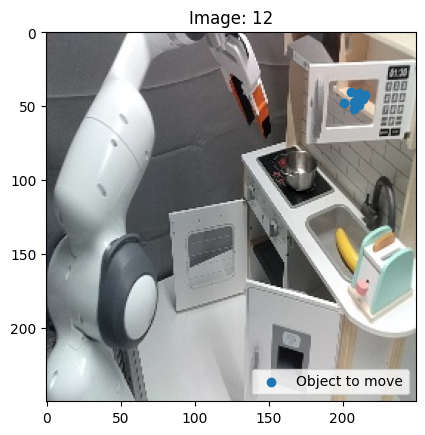

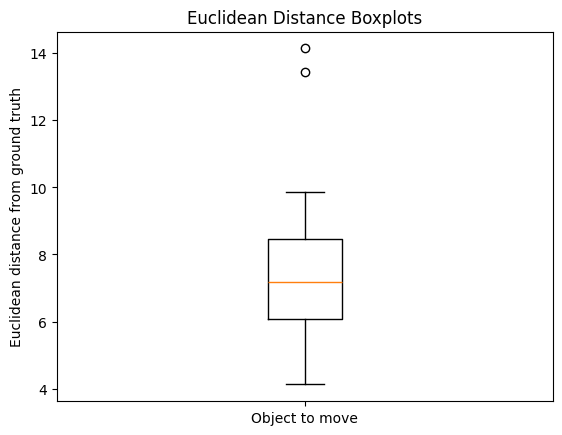

Runs with exactly two coordinates: 10


Run: 2 - Output:  (81.3, 19.0), (81.3, 10.3)
Run: 4 - Output:  (84.0, 15.8), (84.0, 26.2)
Run: 6 - Output:  (85.4, 18.0), (85.4, 24.5)
Run: 8 - Output:  (82.0, 17.5), (82.0, 27.1)
Run: 10 - Output:  (84.7, 19.6), (85.3, 11.1)


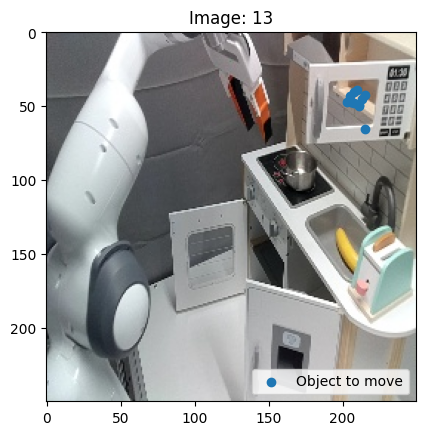

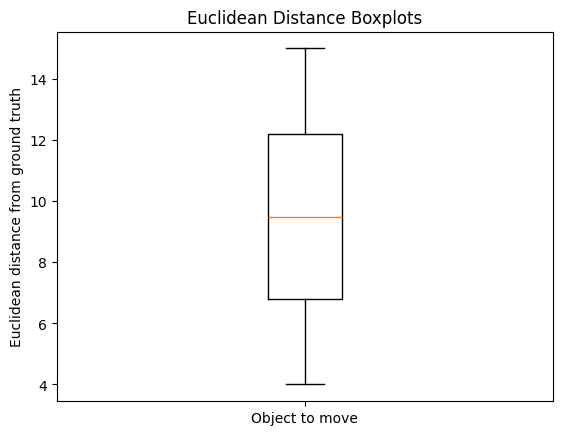

Runs with exactly two coordinates: 10


Run: 2 - Output:  (85.4, 19.2), (85.4, 26.1)
Run: 4 - Output:  (87.0, 19.6), (87.0, 11.1)
Run: 6 - Output:  (83.7, 12.6), (83.7, 23.8)
Run: 8 - Output:  (85.1, 14.6), (85.1, 22.4)
Run: 10 - Output:  (84.4, 20.1), (84.4, 12.0)


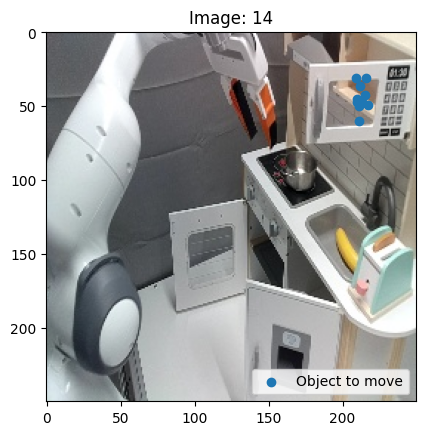

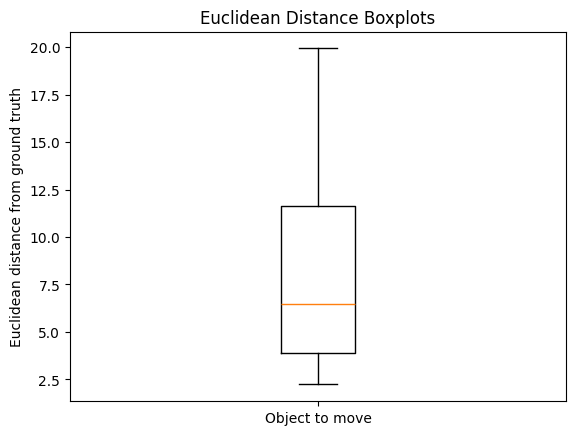

Runs with exactly two coordinates: 10


Run: 2 - Output:  (86.5, 17.8), (86.5, 25.8)
Run: 4 - Output:  (85.1, 19.9), (85.1, 26.6)
Run: 6 - Output:  (84.7, 19.0), (84.7, 12.9)
Run: 8 - Output:  (83.1, 19.5), (83.1, 26.2)
Run: 10 - Output:  (85.9, 19.6), (86.5, 11.0)


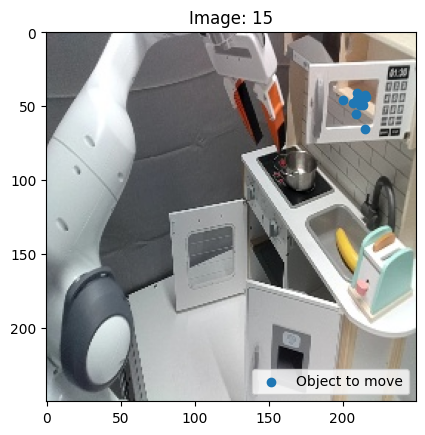

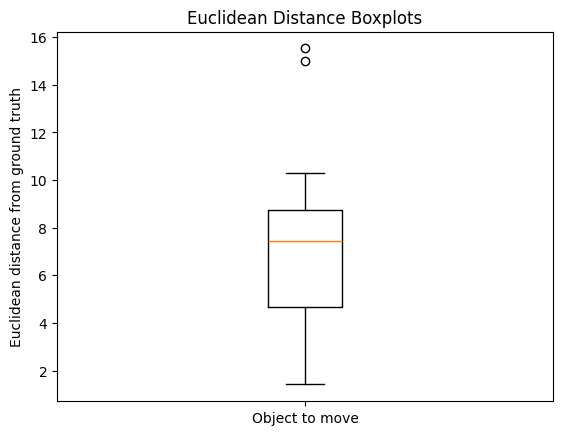

Runs with exactly two coordinates: 10


Run: 2 - Output:  (83.5, 20.7), (83.5, 12.5)
Run: 4 - Output:  (83.7, 19.7), (84.0, 10.0)
Run: 6 - Output:  (82.6, 23.0), (82.6, 13.1)
Run: 8 - Output:  (85.5, 18.0), (86.0, 10.6)
Run: 10 - Output:  (84.4, 28.0), (86.4, 14.6)


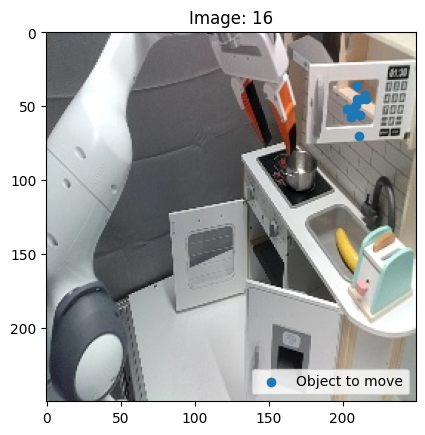

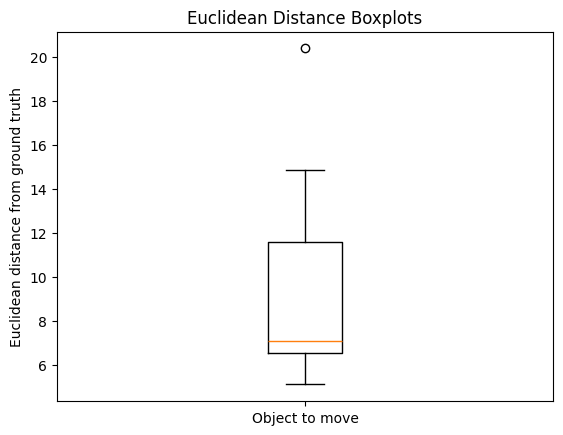

Runs with exactly two coordinates: 10


Run: 2 - Output:  (83.7, 19.5), (83.7, 10.2)
Run: 4 - Output:  (84.0, 18.0), (84.0, 26.0)
Run: 6 - Output:  (82.6, 22.2), (82.6, 13.0)
Run: 8 - Output:  (80.2, 26.1), (76.5, 15.2)
Run: 10 - Output:  (81.6, 19.5), (81.6, 10.7)


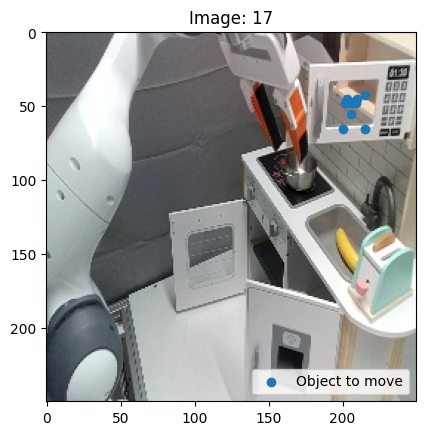

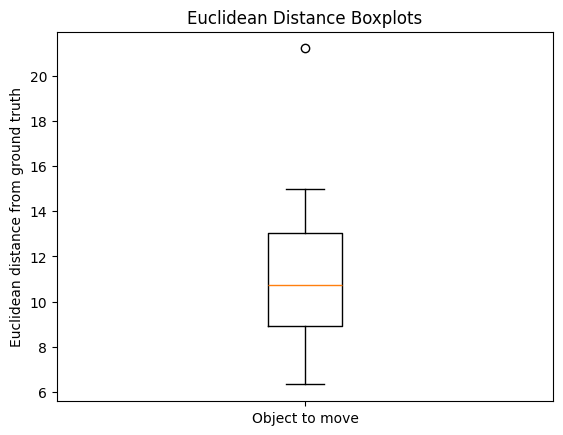

Runs with exactly two coordinates: 10


Run: 2 - Output:  (46.5, 54.6), (53.5, 42.9)
Run: 4 - Output:  (46.0, 58.5), (48.2, 45.0)
Run: 6 - Output:  (46.5, 56.5), (48.0, 48.8)
Run: 8 - Output:  (45.8, 61.5), (50.0, 49.0)
Run: 10 - Output:  (46.0, 58.5), (54.2, 45.6)


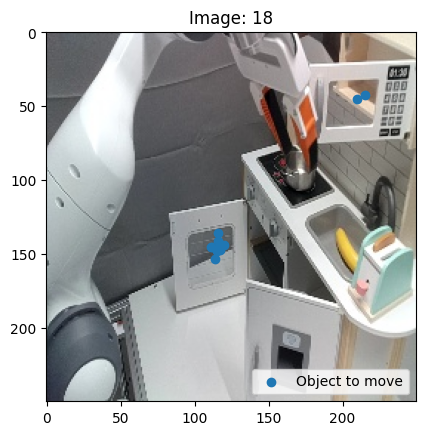

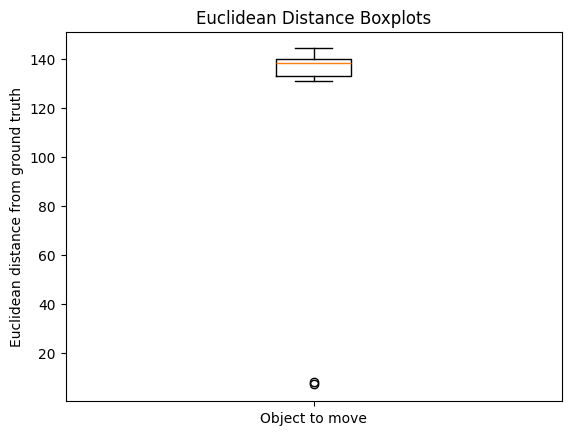

Runs with exactly two coordinates: 10


Run: 2 - Output:  (46.0, 57.2), (52.0, 47.7)
Run: 4 - Output:  (47.0, 58.1), (51.2, 47.0)
Run: 6 - Output:  (44.8, 59.2), (46.0, 49.4)
Run: 8 - Output:  (45.1, 57.8), (45.1, 57.8)
Run: 10 - Output:  (45.1, 58.5), (45.1, 50.0)


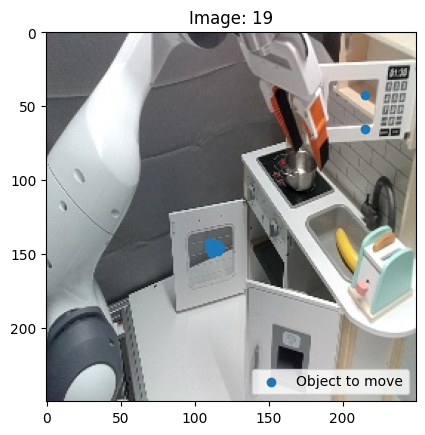

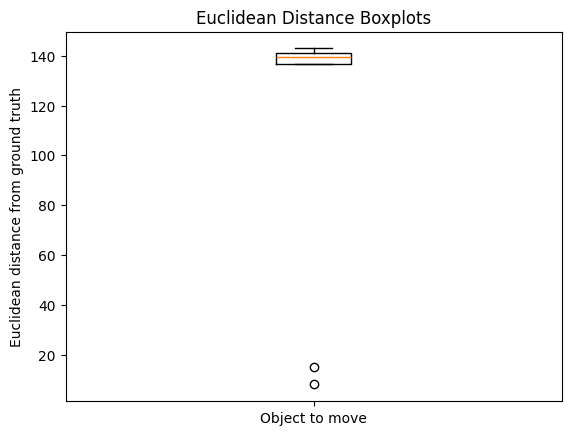

Runs with exactly two coordinates: 10


Run: 2 - Output:  (44.5, 60.0), (46.0, 51.3)
Run: 4 - Output:  (44.2, 57.0), (48.3, 46.5)
Run: 6 - Output:  (46.0, 58.9), (46.0, 58.9)
Run: 8 - Output:  (43.2, 58.2), (43.2, 58.2)
Run: 10 - Output:  (44.5, 58.6), (46.5, 48.0)


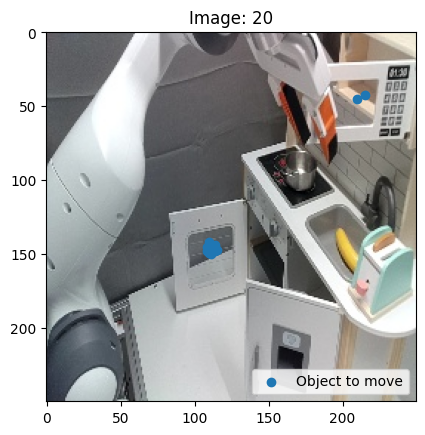

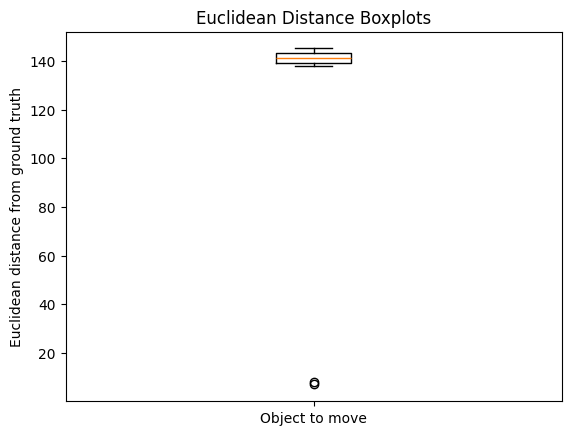

Runs with exactly two coordinates: 10


Run: 2 - Output:  (43.1, 55.6), (43.1, 66.7)
Run: 4 - Output:  (43.2, 59.0), (45.3, 46.2)
Run: 6 - Output:  (45.1, 60.3), (45.1, 69.8)
Run: 8 - Output:  (44.2, 59.3), (44.2, 59.3)
Run: 10 - Output:  (44.1, 60.0), (44.1, 60.0)


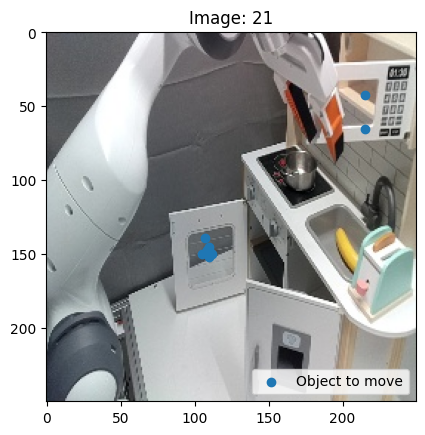

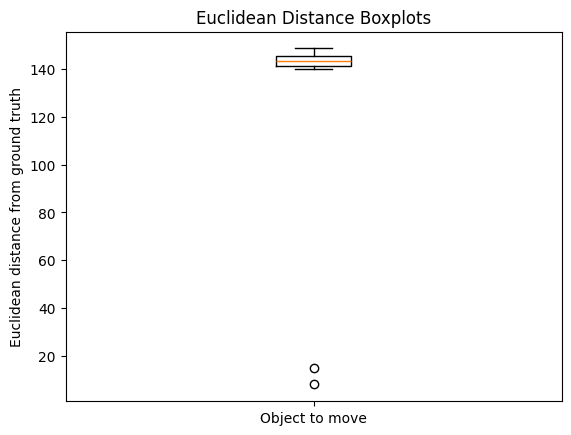

Runs with exactly two coordinates: 10


Run: 2 - Output:  (46.5, 59.0), (49.9, 90.8)
Run: 4 - Output:  (46.2, 59.7), (46.2, 68.8)
Run: 6 - Output:  (45.1, 58.0), (46.3, 46.3)
Run: 8 - Output:  (44.5, 60.0), (45.8, 42.7)
Run: 10 - Output:  (45.1, 58.8), (48.0, 44.0)


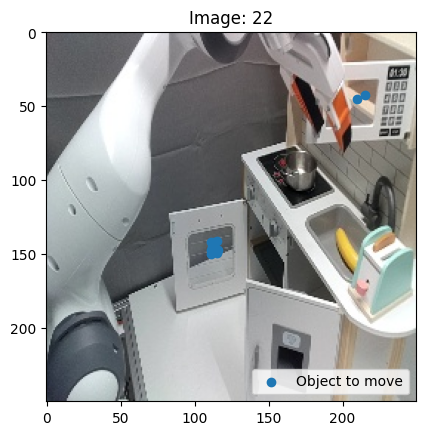

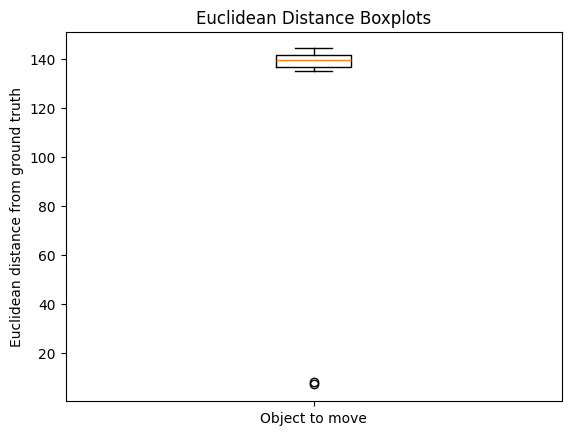

Runs with exactly two coordinates: 10


Run: 2 - Output:  (46.0, 59.8), (46.0, 68.7)
Run: 4 - Output:  (45.8, 58.7), (48.3, 48.3)
Run: 6 - Output:  (46.0, 58.5), (46.0, 58.5)
Run: 8 - Output:  (47.5, 58.2), (47.5, 58.2)
Run: 10 - Output:  (46.5, 59.9), (48.1, 43.0)


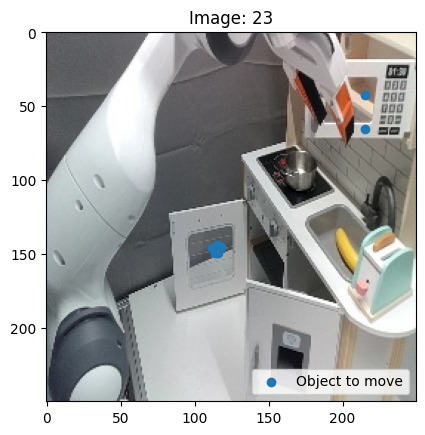

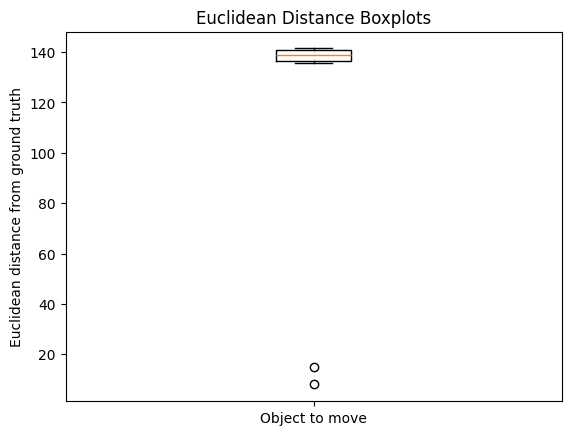

Runs with exactly two coordinates: 10


Run: 2 - Output:  (46.0, 58.6), (46.0, 66.1)
Run: 4 - Output:  (47.1, 57.7), (47.1, 57.7)
Run: 6 - Output:  (46.0, 59.9), (47.2, 48.5)
Run: 8 - Output:  (45.1, 58.4), (47.1, 45.1)
Run: 10 - Output:  (46.0, 55.4), (49.1, 48.0)


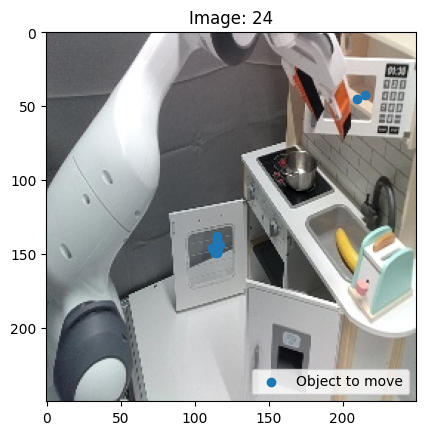

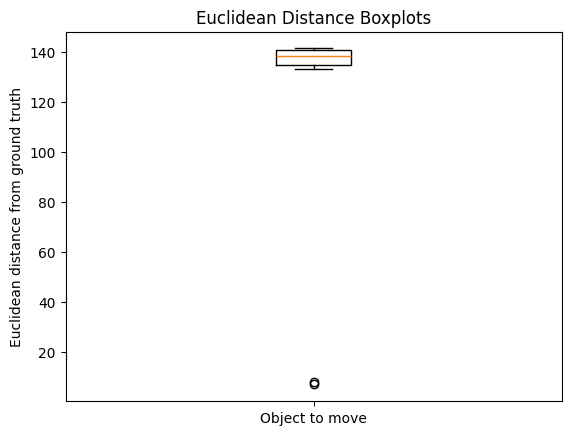

Runs with exactly two coordinates: 10


Run: 2 - Output:  (45.1, 59.0), (51.0, 50.5)
Run: 4 - Output:  (45.5, 58.3), (46.0, 45.5)
Run: 6 - Output:  (45.1, 59.2), (49.2, 47.8)
Run: 8 - Output:  (46.5, 58.2), (48.0, 48.4)
Run: 10 - Output:  (46.5, 59.6), (47.2, 47.5)


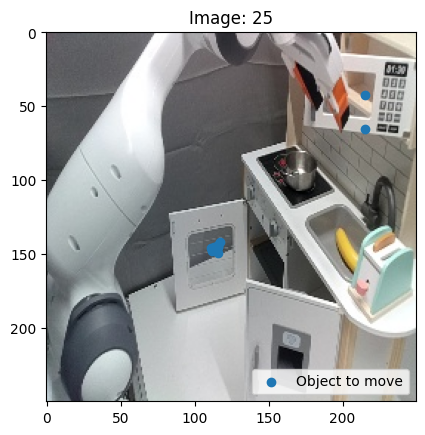

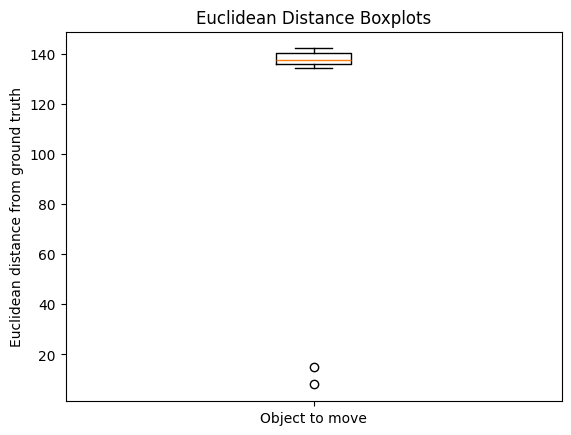

Runs with exactly two coordinates: 10


Run: 2 - Output:  (47.8, 58.0), (54.6, 46.6)
Run: 4 - Output:  (46.8, 59.0), (48.2, 49.5)
Run: 6 - Output:  (47.0, 56.0), (47.0, 56.0)
Run: 8 - Output:  (48.2, 58.0), (48.2, 47.3)
Run: 10 - Output:  (48.1, 58.3), (51.3, 51.3)


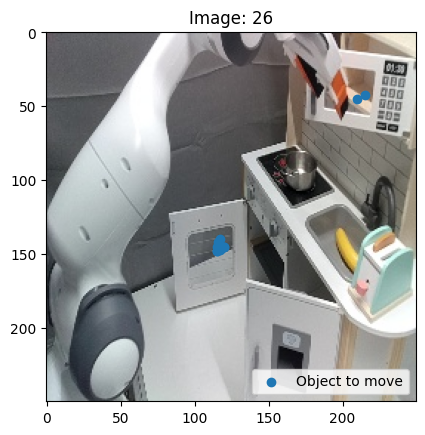

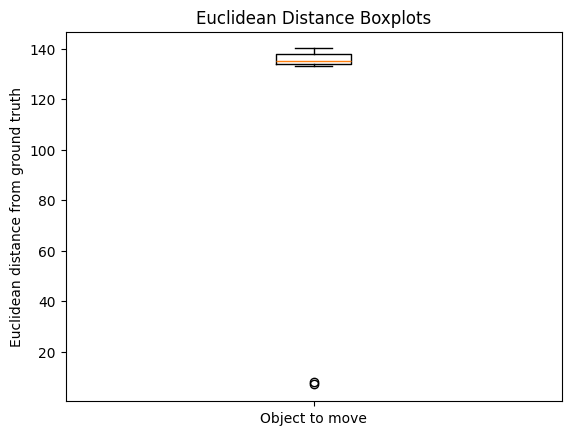

Runs with exactly two coordinates: 10


Run: 2 - Output:  (46.8, 57.0), (48.8, 48.9)
Run: 4 - Output:  (48.1, 55.8), (51.0, 48.1)
Run: 6 - Output:  (46.2, 58.0), (50.0, 48.8)
Run: 8 - Output:  (45.8, 58.3), (48.1, 47.0)
Run: 10 - Output:  (46.5, 59.2), (49.0, 48.7)


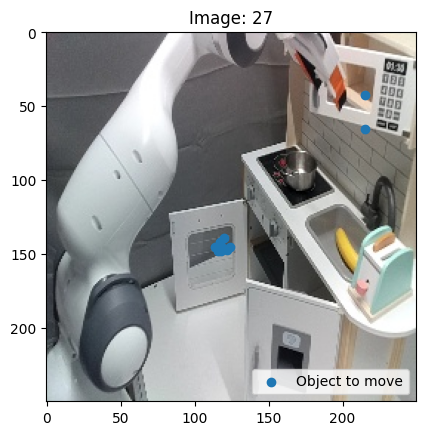

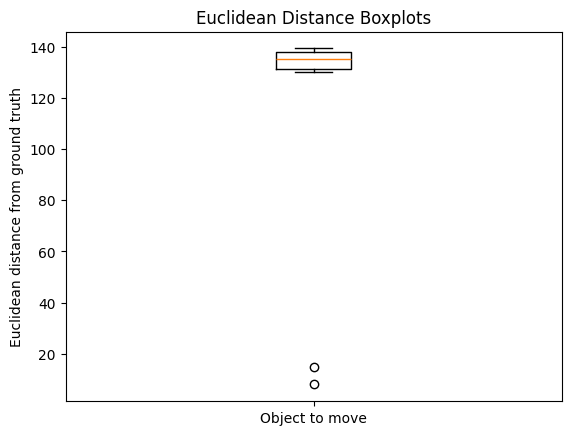

Runs with exactly two coordinates: 10


Run: 2 - Output:  (47.0, 58.3), (50.2, 50.2)
Run: 4 - Output:  (47.0, 57.9), (52.7, 87.9)
Run: 6 - Output:  (47.0, 56.0), (50.0, 49.5)
Run: 8 - Output:  (46.5, 57.2), (51.5, 91.5)
Run: 10 - Output:  (44.6, 57.3), (55.0, 91.0)


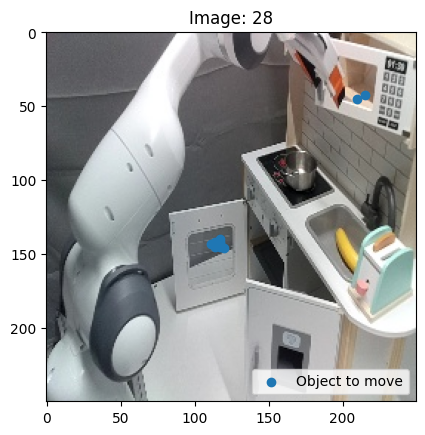

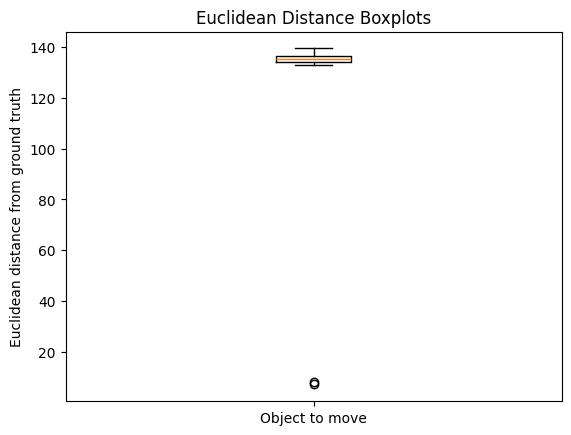

Runs with exactly two coordinates: 10


Run: 2 - Output:  (46.5, 57.6), (49.1, 48.3)
Run: 4 - Output:  (46.5, 55.9), (49.5, 49.7)
Run: 6 - Output:  (47.7, 57.3), (49.4, 48.8)
Run: 8 - Output:  (47.4, 55.9), (48.6, 48.9)
Run: 10 - Output:  (46.5, 57.9), (51.0, 49.5)


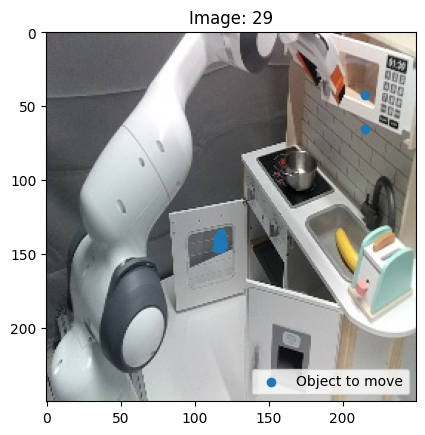

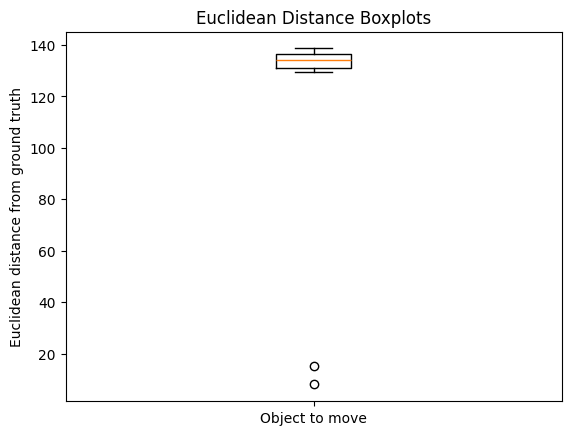

Runs with exactly two coordinates: 10


Run: 2 - Output:  (89.4, 13.2), (89.4, 19.6)
Run: 4 - Output:  (82.6, 10.5), (88.1, 12.7)
Run: 6 - Output:  (89.5, 12.5), (89.5, 18.2)
Run: 8 - Output:  (88.2, 10.0), (88.2, 15.3)
Run: 10 - Output:  (87.6, 15.0), (87.6, 10.2)


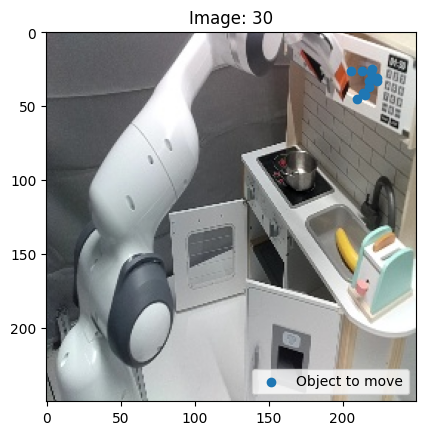

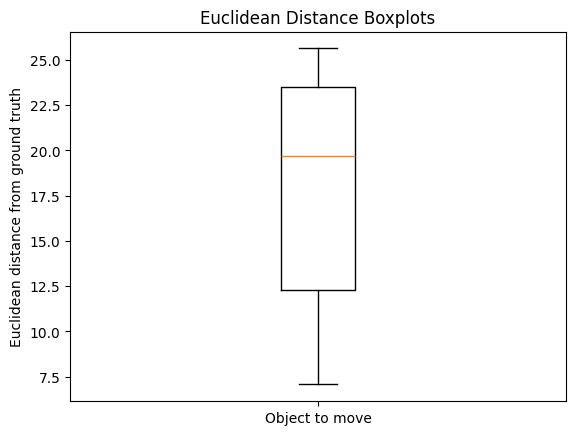

Runs with exactly two coordinates: 10


Run: 2 - Output:  (85.6, 12.5), (86.9, 17.5)
Run: 4 - Output:  (84.0, 10.0), (84.0, 15.0)
Run: 6 - Output:  (85.8, 12.6), (86.2, 19.7)
Run: 8 - Output:  (85.6, 14.4), (86.5, 10.0)
Run: 10 - Output:  (86.3, 17.2), (86.3, 10.7)


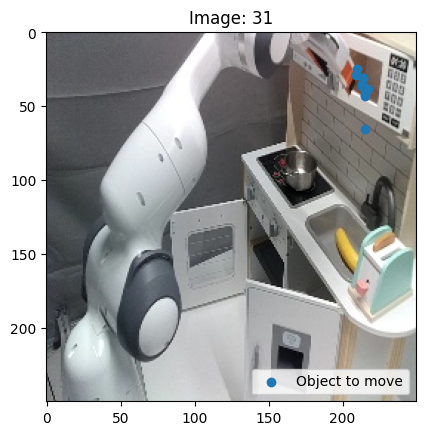

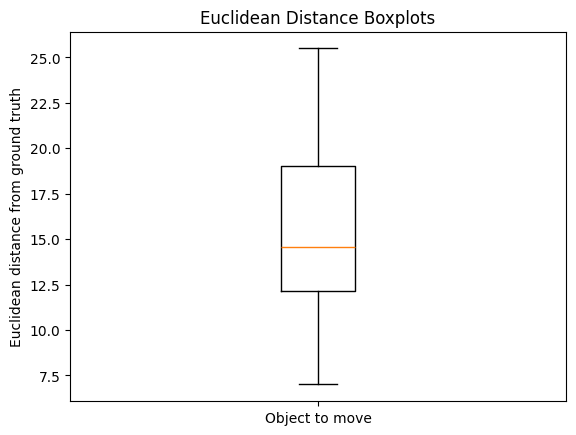

Runs with exactly two coordinates: 10


Run: 2 - Output:  (85.5, 10.0), (85.5, 15.0)
Run: 4 - Output:  (83.5, 11.5), (86.5, 15.6)
Run: 6 - Output:  (84.5, 10.0), (85.3, 17.0)
Run: 8 - Output:  (85.5, 13.1), (86.1, 10.0)
Run: 10 - Output:  (84.5, 10.5), (84.5, 15.9)


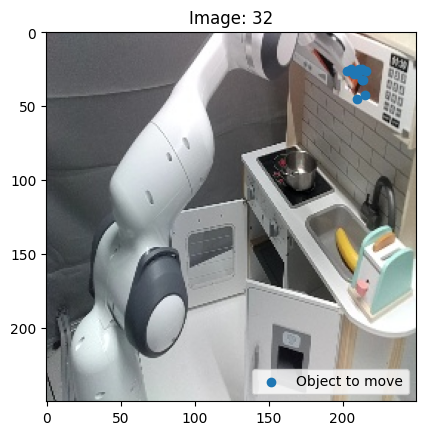

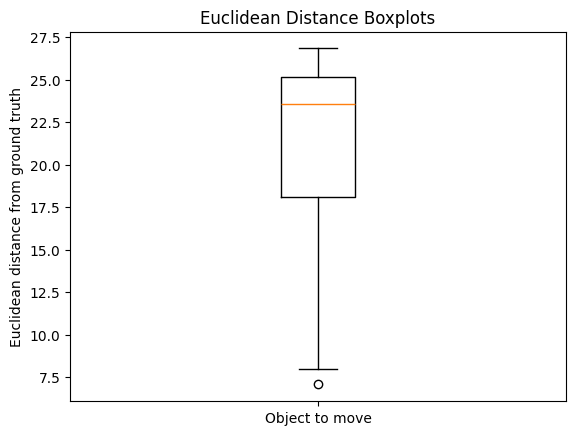

Runs with exactly two coordinates: 10


Run: 2 - Output:  (87.9, 11.5), (88.1, 15.9)
Run: 4 - Output:  (87.1, 10.5), (87.1, 14.5)
Run: 6 - Output:  (87.1, 10.8), (87.1, 17.2)
Run: 8 - Output:  (87.9, 13.5), (88.0, 10.1)
Run: 10 - Output:  (85.6, 10.0), (85.6, 15.6)


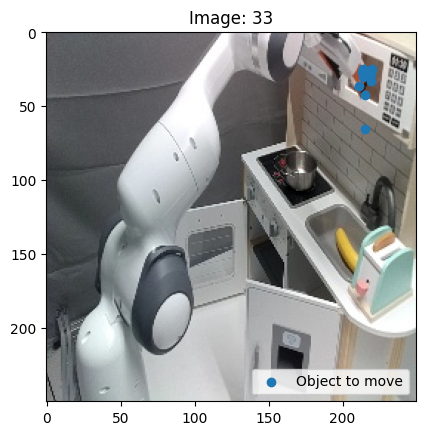

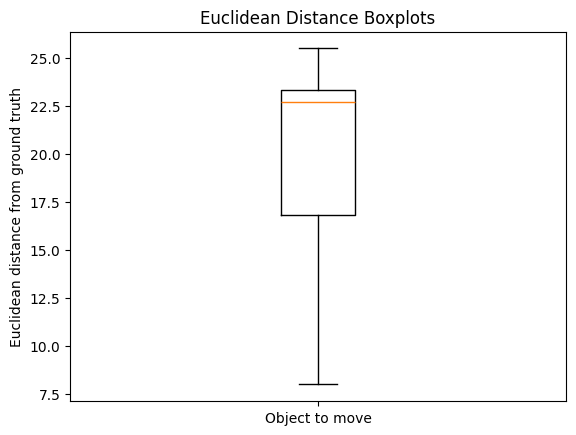

Runs with exactly two coordinates: 10


Run: 2 - Output:  (86.5, 11.2), (89.3, 11.2)
Run: 4 - Output:  (85.4, 10.6), (86.4, 16.1)
Run: 6 - Output:  (86.5, 10.5), (86.5, 15.0)
Run: 8 - Output:  (87.2, 12.5), (87.2, 10.0)
Run: 10 - Output:  (86.5, 10.2), (86.5, 15.3)


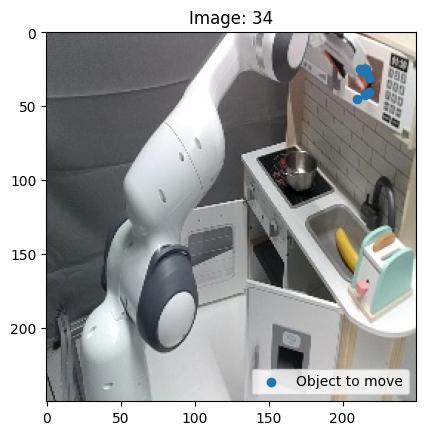

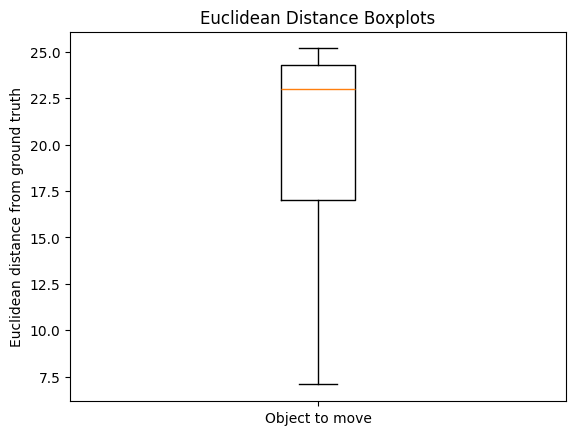

Runs with exactly two coordinates: 10


Run: 2 - Output:  (51.7, 52.6), (52.6, 51.7)
Run: 4 - Output:  (50.2, 50.0), (50.2, 50.0)
Run: 6 - Output:  (51.9, 51.3), (51.9, 55.5)
Run: 8 - Output:  (51.1, 53.6), (54.6, 54.4)
Run: 10 - Output:  (50.2, 51.5), (56.2, 51.5)


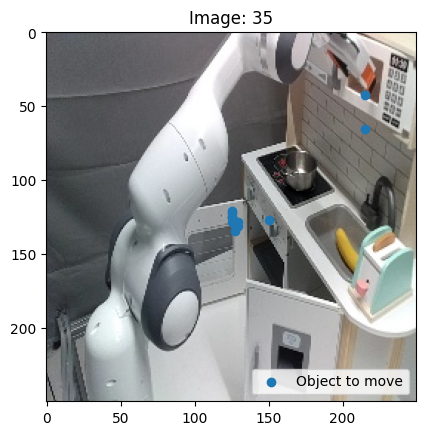

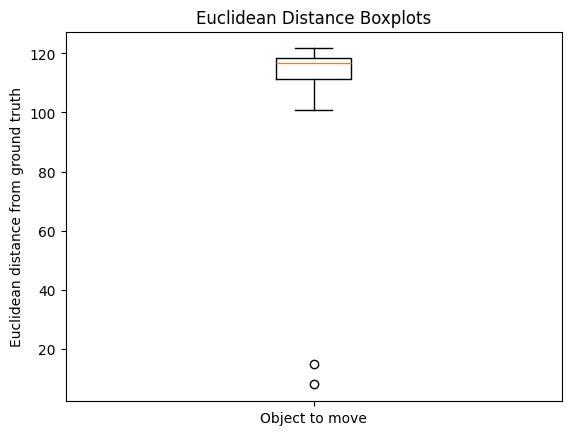

Runs with exactly two coordinates: 10


Run: 2 - Output:  (50.2, 54.8), (50.2, 54.8)
Run: 4 - Output:  (50.0, 50.0), (50.0, 50.0)
Run: 6 - Output:  (48.2, 55.0), (53.5, 53.5)
Run: 8 - Output:  (49.2, 56.5), (51.6, 45.7)
Run: 10 - Output:  (50.2, 50.0), (54.5, 50.0)


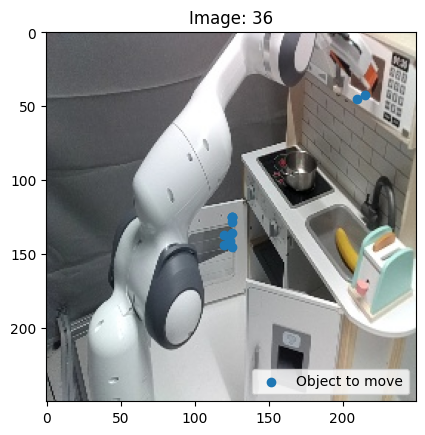

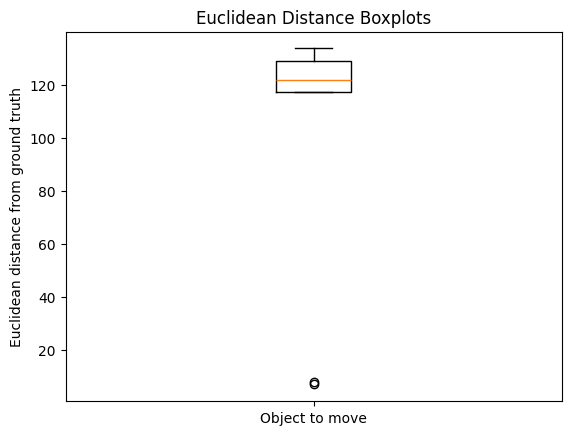

Runs with exactly two coordinates: 10


Run: 2 - Output:  (52.0, 56.1), (52.0, 56.1)
Run: 4 - Output:  (51.4, 55.2), (51.4, 48.2)
Run: 6 - Output:  (50.2, 50.0), (55.5, 50.0)
Run: 8 - Output:  (51.4, 54.6), (51.4, 45.7)
Run: 10 - Output:  (50.0, 49.2), (50.0, 50.0)


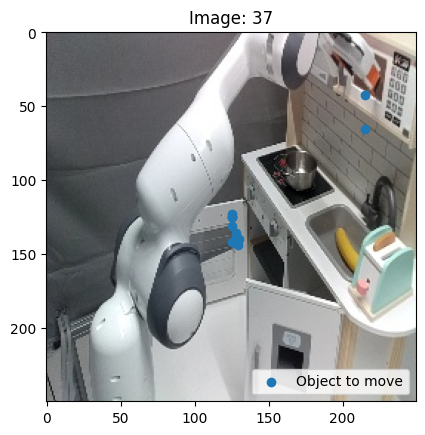

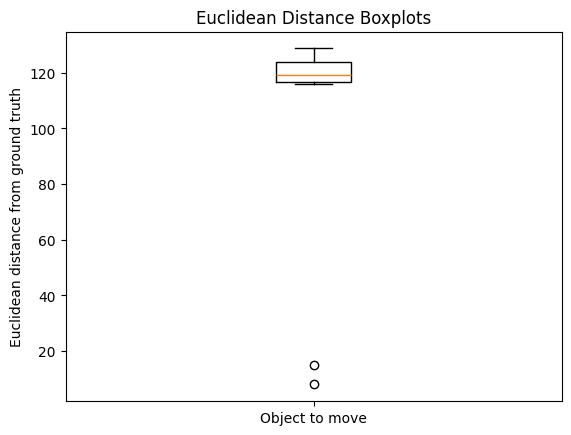

Runs with exactly two coordinates: 10


Run: 2 - Output:  (50.2, 50.0), (50.2, 50.0)
Run: 4 - Output:  (50.2, 56.5), (50.2, 57.7)
Run: 6 - Output:  (50.0, 50.0), (55.6, 50.0)
Run: 8 - Output:  (49.8, 58.1), (50.0, 46.7)
Run: 10 - Output:  (51.2, 53.8), (51.2, 58.0)


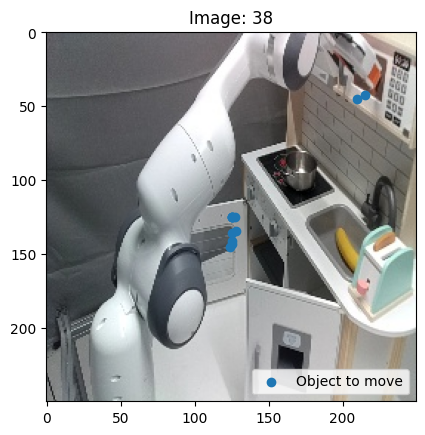

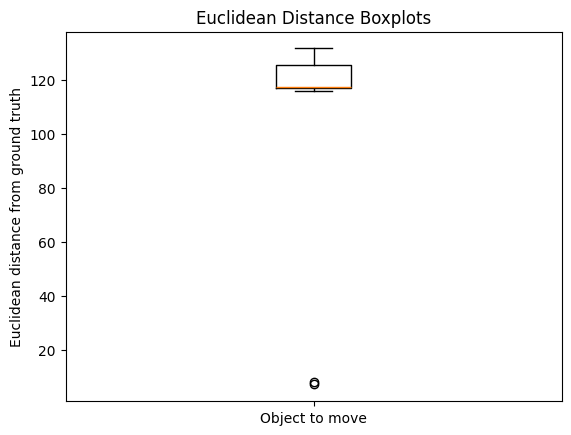

Runs with exactly two coordinates: 10


Run: 2 - Output:  (50.0, 50.0), (59.8, 50.0)
Run: 4 - Output:  (50.0, 49.2), (50.0, 50.0)
Run: 6 - Output:  (50.2, 51.4), (50.2, 51.4)
Run: 8 - Output:  (49.5, 58.1), (56.7, 54.2)
Run: 10 - Output:  (49.8, 57.0), (50.2, 50.2)


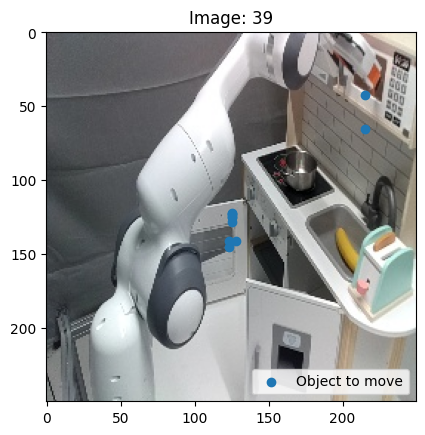

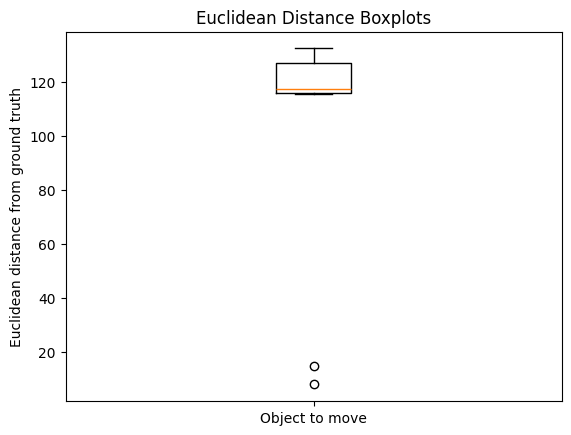

Runs with exactly two coordinates: 10


Run: 2 - Output:  (50.2, 51.0), (50.2, 51.0)
Run: 4 - Output:  (48.1, 51.0), (54.5, 53.2)
Run: 6 - Output:  (50.2, 53.2), (50.2, 53.2)
Run: 8 - Output:  (48.1, 52.0), (55.1, 52.0)
Run: 10 - Output:  (50.0, 50.0), (50.0, 50.0)


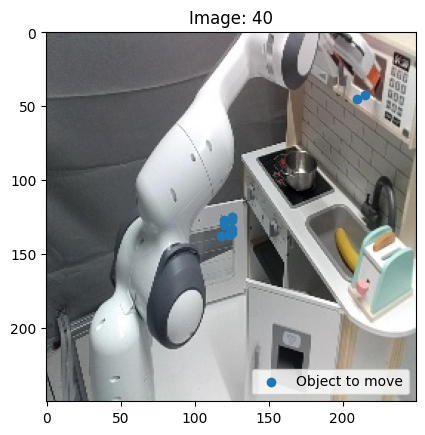

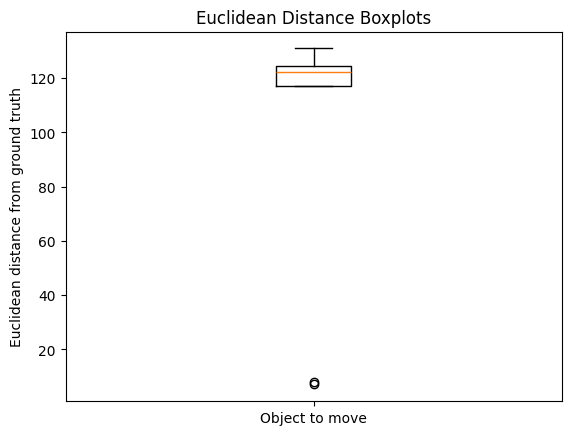

Runs with exactly two coordinates: 10


Run: 2 - Output:  (51.4, 53.2), (51.4, 53.2)
Run: 4 - Output:  (50.0, 50.0), (55.5, 50.0)
Run: 6 - Output:  (50.0, 50.0), (55.6, 50.0)
Run: 8 - Output:  (49.1, 50.5), (52.7, 51.0)
Run: 10 - Output:  (50.2, 50.0), (50.2, 50.0)


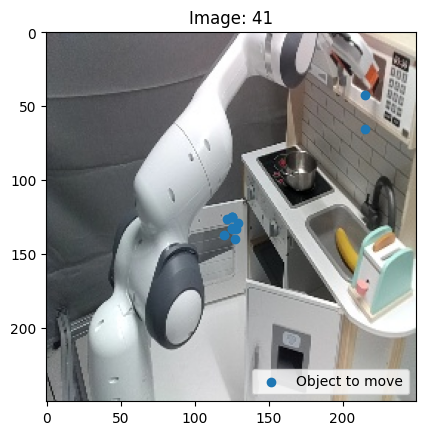

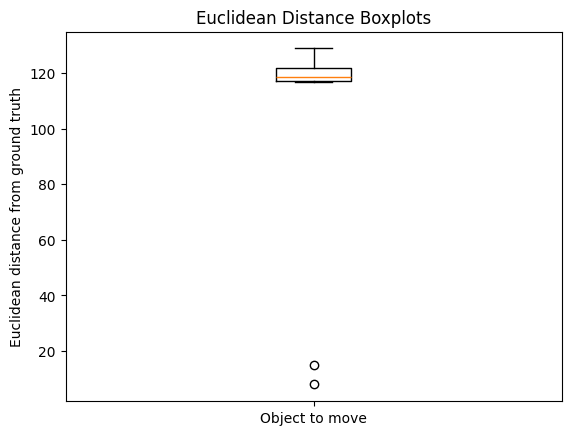

Runs with exactly two coordinates: 10


Run: 2 - Output:  (88.4, 13.0), (88.4, 18.8)
Run: 4 - Output:  (88.9, 11.5), (89.0, 15.9)
Run: 6 - Output:  (88.2, 10.0), (88.2, 15.2)
Run: 8 - Output:  (89.7, 10.5), (89.7, 15.4)
Run: 10 - Output:  (88.2, 13.5), (88.2, 10.4)


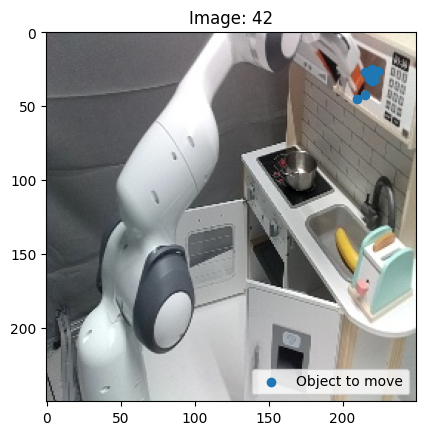

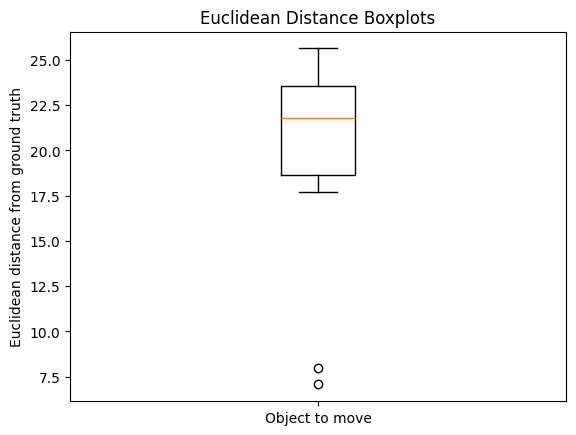

Runs with exactly two coordinates: 10




In [23]:
tasks, trajectories, ground_truths, _ = extract_all_trajectories("../data/trajectory_kit")

for i in range(len(tasks)):
    outputs = []
    trajectory = trajectories[i]
    ground_truth = ground_truths[i]
    task = tasks[i]
    prompt = prompt_start + task + prompt_1 + prompt_end

    if (task == "close the microwave."):
        print(f"Task: {task}")
        for k, image in enumerate(trajectory):
            runs_with_two_coords = 0
            image_width = image.width
            image_height = image.height
            for j in range(10):
                output = do_inference(image, prompt, model, processor)
                coordinates = get_coordinates(output, image_width, image_height)
                if len(coordinates) == 2:
                    runs_with_two_coords += 1
                    outputs.append(coordinates)
        
                if ((j+1) % 2) == 0: 
                    print(f"Run: {j + 1} - Output: {output}")
        
            labels = ["Object to move"]
            title = "Image: " + str(k)
            
            outputs = refactor_coordinates_to_where_to_place(outputs)
            visualize_points_on_image(image, labels, outputs, title)
            plot_euclidean_bplot2(labels, outputs, ground_truth, title)
            print(f"Runs with exactly two coordinates: {runs_with_two_coords}")
            print("")
            print("")